**Installation of SimPy""
If not available**

In [1]:
#!pip install simpy

**Import of required modules**

In [2]:
import simpy
import numpy as np
import numpy.random as random

**Parameters settings**

In [3]:
MAXSIMTIME = 50000
VERBOSE = True
LAMBDA = 6.8
MU = 8.0
POPULATION = 50000000
MAXWAITTIME = 3
LOGGED = True
PLOTTED = True
RENEGED = True
FIXEDWAITIME = True

**Discrete-Event Simulation model**


**The definition of a job**.

The properties of a job are


1. job execution time
2. job arrival time
3. job maximum waiting time

In [4]:
class Job:
    def __init__(self, name, arrtime, duration, maxwaittime):
        self.name = name
        self.arrtime = arrtime
        self.duration = duration
        self.maxwaittime = maxwaittime

    def __str__(self):
        return '%s at %.3f, duration %.3f, max waiting %.3f' %(self.name, self.arrtime, self.duration, self.maxwaittime)

**The definition of server**

 There are 2 arguments needed for a server:
 1. env: SimPy environment
 2. queue discipline: FIFO - First In First Out

In [5]:
class Server:
    def __init__(self, env, strat = 'FIFO'):
        self.env = env
        self.strat = strat
        self.Jobs = list(())
        self.serversleeping = None
        ### Statistics
        self.waitingTime = 0
        self.idleTime = 0
        self.jobsDone = 0
        ### Register a new server process
        env.process(self.serve())

    def serve(self):
        while True:
            ''' Do nothing, just change server to idle
            and then yield a wait event which takes infinite time
            '''
            if len(self.Jobs) == 0:
                self.serversleeping = env.process(self.waiting(self.env))
                t1 = self.env.now
                yield self.serversleeping
                ### Accumulate the server idle time
                self.idleTime += self.env.now - t1
            else:
                ### Get the first job to be served
                if self.strat == 'SJF':
                    self.Jobs.sort(key = SJF)
                    j = self.Jobs.pop(0)
                else: # FIFO by default
                    j = self.Jobs.pop(0)
                if LOGGED:
                    qlog.write('%.4f\t%d\t%d\n' 
                        %(self.env.now, 1 if len(self.Jobs) > 0 else 0, len(self.Jobs)))

                ### Sum up the waiting time
                self.waitingTime += self.env.now - j.arrtime
                ### Yield an event for the job finish
                yield self.env.timeout(j.duration)
                ### Sum up the jobs done 
                self.jobsDone += 1

    def waiting(self, env):
        try:
            if VERBOSE:
                print('Server is idle at %.2f' %self.env.now)
            yield self.env.timeout(MAXSIMTIME)
        except simpy.Interrupt as i:
            if VERBOSE:
                 print('Server waken up and works at %.2f' %self.env.now)
                    

**The arrival process**

The arrival process is exponentially distributed which is parameterized by
1. number of servers
2. maximum number of population
3. arrival rate $\lambda$
4. service rate $\mu$
*Note that, the implementation of the arrival process embeds both arrival and service distributions.*

In [6]:
class JobGenerator:
    def __init__(self, env, server, nrjobs = 10000000, lam = 5, mu = 8, maxwait = 6):
        self.server = server
        self.nrjobs = nrjobs
        self.interarrivaltime = 1/lam
        self.servicetime = 1/mu
        self.maxwaittime = maxwait
        ## Statistics
        self.totalJob = 0
        ### Register a new job generator process
        env.process(self.generateJobs(env))
        
    def generateJobs(self, env):
        while True:
            ### Yield an event for new job arrival
            jobInterarrival = random.exponential(self.interarrivaltime)
            yield env.timeout(jobInterarrival)

            ### Generate service time and add job to the list
            job_duration = random.exponential(self.servicetime)
            if FIXEDWAITIME:
                max_waittime = self.maxwaittime
            else:
                max_waittime = random.exponential(self.maxwaittime)
            job = Job('Job %s' %(self.totalJob + 1), env.now, job_duration, max_waittime)
            self.server.Jobs.append(job)
            ### Register new process for renege job
            if RENEGED:
                env.process(self.renegeJob(env, job))
            if VERBOSE:
                print('Finish %s: t = %.2f, l = %.2f, dt = %.2f' 
                    %(job.name, env.now, job.duration, jobInterarrival))
            self.totalJob += 1

            ### If server is idle, wake it up'''
            if not self.server.serversleeping.triggered:
                self.server.serversleeping.interrupt('Wake up, please.')
    
    def renegeJob(self, env, job):
        yield env.timeout(job.maxwaittime)
        if job in self.server.Jobs:
            if VERBOSE:
                print('RENEGE ', job)
            self.server.Jobs.remove(job)


**Open the log file**

If requested.

In [7]:
if LOGGED:
    if RENEGED:
        qlog = open('mm1SD-l%d-m%d-w%d.csv' %(LAMBDA, MU, MAXWAITTIME), 'w')
    else:
        qlog = open('mm1-l%d-m%d.csv' %(LAMBDA, MU), 'w')
    qlog.write('0\t0\t0\n' )

**Start SimPy environment**

In [8]:
env = simpy.Environment()
MyServer = Server(env, 'FIFO')
MyJobGenerator = JobGenerator(env, MyServer, POPULATION, LAMBDA, MU, MAXWAITTIME)

**Run the simulation** 

In [9]:
env.run(until = MAXSIMTIME)

Server is idle at 0.00
Finish Job 1: t = 0.06, l = 0.16, dt = 0.06
Server waken up and works at 0.06
Finish Job 2: t = 0.06, l = 0.28, dt = 0.01
Finish Job 3: t = 0.22, l = 0.12, dt = 0.15
Finish Job 4: t = 0.34, l = 0.08, dt = 0.12
Finish Job 5: t = 0.55, l = 0.00, dt = 0.21
Finish Job 6: t = 0.59, l = 0.02, dt = 0.05
Finish Job 7: t = 0.61, l = 0.00, dt = 0.02
Finish Job 8: t = 0.64, l = 0.12, dt = 0.03
Finish Job 9: t = 0.73, l = 0.21, dt = 0.09
Server is idle at 1.04
Finish Job 10: t = 1.08, l = 0.08, dt = 0.34
Server waken up and works at 1.08
Finish Job 11: t = 1.09, l = 0.14, dt = 0.01
Server is idle at 1.29
Finish Job 12: t = 1.33, l = 0.31, dt = 0.24
Server waken up and works at 1.33
Finish Job 13: t = 1.34, l = 0.04, dt = 0.01
Finish Job 14: t = 1.39, l = 0.10, dt = 0.06
Finish Job 15: t = 1.44, l = 0.01, dt = 0.05
Finish Job 16: t = 1.51, l = 0.05, dt = 0.06
Finish Job 17: t = 1.72, l = 0.13, dt = 0.22
Finish Job 18: t = 1.82, l = 0.14, dt = 0.10
Finish Job 19: t = 1.91, l =

Finish Job 1964: t = 302.99, l = 0.09, dt = 0.04
Finish Job 1965: t = 303.06, l = 0.01, dt = 0.07
Finish Job 1966: t = 303.23, l = 0.09, dt = 0.17
Finish Job 1967: t = 303.47, l = 0.12, dt = 0.24
Finish Job 1968: t = 303.49, l = 0.01, dt = 0.02
Finish Job 1969: t = 303.63, l = 0.08, dt = 0.14
Finish Job 1970: t = 303.70, l = 0.25, dt = 0.07
Finish Job 1971: t = 303.81, l = 0.45, dt = 0.11
Finish Job 1972: t = 303.97, l = 0.07, dt = 0.16
Finish Job 1973: t = 304.07, l = 0.11, dt = 0.10
Server is idle at 304.65
Finish Job 1974: t = 304.78, l = 0.16, dt = 0.72
Server waken up and works at 304.78
Server is idle at 304.94
Finish Job 1975: t = 305.18, l = 0.02, dt = 0.40
Server waken up and works at 305.18
Server is idle at 305.20
Finish Job 1976: t = 305.25, l = 0.05, dt = 0.06
Server waken up and works at 305.25
Server is idle at 305.30
Finish Job 1977: t = 305.32, l = 0.08, dt = 0.07
Server waken up and works at 305.32
Server is idle at 305.40
Finish Job 1978: t = 305.70, l = 0.27, dt = 0

Finish Job 4420: t = 672.86, l = 0.16, dt = 0.29
Finish Job 4421: t = 672.97, l = 0.06, dt = 0.11
Finish Job 4422: t = 672.99, l = 0.12, dt = 0.02
Finish Job 4423: t = 673.17, l = 0.02, dt = 0.18
Finish Job 4424: t = 673.24, l = 0.09, dt = 0.07
Finish Job 4425: t = 673.36, l = 0.23, dt = 0.12
Finish Job 4426: t = 673.68, l = 0.01, dt = 0.32
Finish Job 4427: t = 673.69, l = 0.18, dt = 0.01
Finish Job 4428: t = 673.71, l = 0.08, dt = 0.02
Finish Job 4429: t = 673.89, l = 0.35, dt = 0.18
Finish Job 4430: t = 673.89, l = 0.09, dt = 0.00
Finish Job 4431: t = 673.97, l = 0.03, dt = 0.08
Finish Job 4432: t = 674.20, l = 0.19, dt = 0.23
Finish Job 4433: t = 674.48, l = 0.06, dt = 0.28
Finish Job 4434: t = 674.49, l = 0.02, dt = 0.02
Finish Job 4435: t = 674.57, l = 0.03, dt = 0.08
Finish Job 4436: t = 674.65, l = 0.02, dt = 0.07
Finish Job 4437: t = 674.77, l = 0.10, dt = 0.12
Finish Job 4438: t = 674.78, l = 0.02, dt = 0.01
Finish Job 4439: t = 674.95, l = 0.23, dt = 0.16
Finish Job 4440: t =

Finish Job 7734: t = 1148.99, l = 0.35, dt = 0.02
Finish Job 7735: t = 1149.07, l = 0.21, dt = 0.08
Finish Job 7736: t = 1149.14, l = 0.03, dt = 0.06
Server is idle at 1149.60
Finish Job 7737: t = 1150.01, l = 0.08, dt = 0.87
Server waken up and works at 1150.01
Finish Job 7738: t = 1150.04, l = 0.27, dt = 0.03
Finish Job 7739: t = 1150.09, l = 0.04, dt = 0.05
Finish Job 7740: t = 1150.30, l = 0.01, dt = 0.21
Server is idle at 1150.41
Finish Job 7741: t = 1150.49, l = 0.22, dt = 0.19
Server waken up and works at 1150.49
Finish Job 7742: t = 1150.51, l = 0.39, dt = 0.02
Finish Job 7743: t = 1150.59, l = 0.06, dt = 0.08
Finish Job 7744: t = 1150.61, l = 0.02, dt = 0.02
Finish Job 7745: t = 1150.62, l = 0.42, dt = 0.01
Finish Job 7746: t = 1150.63, l = 0.43, dt = 0.00
Finish Job 7747: t = 1150.96, l = 0.04, dt = 0.33
Finish Job 7748: t = 1151.10, l = 0.33, dt = 0.14
Finish Job 7749: t = 1151.11, l = 0.02, dt = 0.01
Finish Job 7750: t = 1151.24, l = 0.08, dt = 0.13
Finish Job 7751: t = 115

Server is idle at 1634.51
Finish Job 11054: t = 1635.00, l = 0.46, dt = 0.55
Server waken up and works at 1635.00
Finish Job 11055: t = 1635.04, l = 0.06, dt = 0.05
Finish Job 11056: t = 1635.34, l = 0.03, dt = 0.30
Finish Job 11057: t = 1635.37, l = 0.03, dt = 0.02
Finish Job 11058: t = 1635.52, l = 0.10, dt = 0.16
Server is idle at 1635.68
Finish Job 11059: t = 1635.72, l = 0.14, dt = 0.20
Server waken up and works at 1635.72
Finish Job 11060: t = 1635.73, l = 0.09, dt = 0.02
Finish Job 11061: t = 1635.93, l = 0.04, dt = 0.20
Finish Job 11062: t = 1635.94, l = 0.07, dt = 0.01
Server is idle at 1636.06
Finish Job 11063: t = 1636.12, l = 0.36, dt = 0.18
Server waken up and works at 1636.12
Server is idle at 1636.48
Finish Job 11064: t = 1636.51, l = 0.26, dt = 0.39
Server waken up and works at 1636.51
Finish Job 11065: t = 1636.60, l = 0.05, dt = 0.09
Server is idle at 1636.82
Finish Job 11066: t = 1636.85, l = 0.15, dt = 0.24
Server waken up and works at 1636.85
Server is idle at 1637

Finish Job 13555: t = 2006.59, l = 0.06, dt = 0.05
Finish Job 13556: t = 2006.76, l = 0.12, dt = 0.17
Finish Job 13557: t = 2006.82, l = 0.26, dt = 0.06
Finish Job 13558: t = 2007.26, l = 0.00, dt = 0.44
Server is idle at 2007.63
Finish Job 13559: t = 2007.67, l = 0.05, dt = 0.40
Server waken up and works at 2007.67
Server is idle at 2007.72
Finish Job 13560: t = 2007.74, l = 0.33, dt = 0.07
Server waken up and works at 2007.74
Finish Job 13561: t = 2007.80, l = 0.08, dt = 0.06
Finish Job 13562: t = 2007.96, l = 0.07, dt = 0.16
Finish Job 13563: t = 2008.01, l = 0.22, dt = 0.04
Finish Job 13564: t = 2008.09, l = 0.11, dt = 0.09
Finish Job 13565: t = 2008.29, l = 0.03, dt = 0.19
Finish Job 13566: t = 2008.46, l = 0.04, dt = 0.17
Finish Job 13567: t = 2008.55, l = 0.00, dt = 0.10
Finish Job 13568: t = 2008.60, l = 0.12, dt = 0.04
Finish Job 13569: t = 2008.64, l = 0.26, dt = 0.04
Finish Job 13570: t = 2008.76, l = 0.00, dt = 0.13
Finish Job 13571: t = 2008.77, l = 0.29, dt = 0.00
Finish 

Server waken up and works at 2527.01
Finish Job 17138: t = 2527.09, l = 0.43, dt = 0.08
Finish Job 17139: t = 2527.15, l = 0.02, dt = 0.06
Finish Job 17140: t = 2527.26, l = 0.09, dt = 0.11
Finish Job 17141: t = 2527.54, l = 0.01, dt = 0.28
Finish Job 17142: t = 2527.56, l = 0.12, dt = 0.02
Finish Job 17143: t = 2527.73, l = 0.01, dt = 0.16
Server is idle at 2527.91
Finish Job 17144: t = 2528.27, l = 0.09, dt = 0.55
Server waken up and works at 2528.27
Finish Job 17145: t = 2528.31, l = 0.24, dt = 0.03
Finish Job 17146: t = 2528.46, l = 0.11, dt = 0.16
Finish Job 17147: t = 2528.55, l = 0.19, dt = 0.09
Finish Job 17148: t = 2528.64, l = 0.01, dt = 0.09
Finish Job 17149: t = 2528.83, l = 0.31, dt = 0.18
Finish Job 17150: t = 2529.04, l = 0.19, dt = 0.21
Finish Job 17151: t = 2529.06, l = 0.05, dt = 0.02
Finish Job 17152: t = 2529.08, l = 0.29, dt = 0.02
Finish Job 17153: t = 2529.23, l = 0.35, dt = 0.15
Finish Job 17154: t = 2529.41, l = 0.02, dt = 0.18
Finish Job 17155: t = 2529.71, l 

Server waken up and works at 3051.10
Server is idle at 3051.16
Finish Job 20581: t = 3051.24, l = 0.01, dt = 0.14
Server waken up and works at 3051.24
Server is idle at 3051.26
Finish Job 20582: t = 3051.33, l = 0.07, dt = 0.09
Server waken up and works at 3051.33
Server is idle at 3051.40
Finish Job 20583: t = 3051.44, l = 0.04, dt = 0.11
Server waken up and works at 3051.44
Server is idle at 3051.48
Finish Job 20584: t = 3051.64, l = 0.07, dt = 0.21
Server waken up and works at 3051.64
Server is idle at 3051.71
Finish Job 20585: t = 3052.06, l = 0.10, dt = 0.41
Server waken up and works at 3052.06
Server is idle at 3052.16
Finish Job 20586: t = 3052.18, l = 0.02, dt = 0.13
Server waken up and works at 3052.18
Server is idle at 3052.20
Finish Job 20587: t = 3052.57, l = 0.04, dt = 0.39
Server waken up and works at 3052.57
Server is idle at 3052.61
Finish Job 20588: t = 3052.69, l = 0.14, dt = 0.12
Server waken up and works at 3052.69
Server is idle at 3052.83
Finish Job 20589: t = 305

Finish Job 24193: t = 3587.70, l = 0.16, dt = 0.02
Finish Job 24194: t = 3587.78, l = 0.06, dt = 0.08
Finish Job 24195: t = 3587.83, l = 0.35, dt = 0.05
Finish Job 24196: t = 3587.92, l = 0.00, dt = 0.09
Finish Job 24197: t = 3588.36, l = 0.19, dt = 0.44
Finish Job 24198: t = 3588.42, l = 0.06, dt = 0.07
Server is idle at 3589.49
Finish Job 24199: t = 3589.76, l = 0.20, dt = 1.33
Server waken up and works at 3589.76
Finish Job 24200: t = 3589.88, l = 0.03, dt = 0.12
Server is idle at 3589.98
Finish Job 24201: t = 3590.01, l = 0.14, dt = 0.13
Server waken up and works at 3590.01
Finish Job 24202: t = 3590.04, l = 0.36, dt = 0.03
Finish Job 24203: t = 3590.19, l = 0.14, dt = 0.15
Finish Job 24204: t = 3590.27, l = 0.05, dt = 0.07
Finish Job 24205: t = 3590.33, l = 0.05, dt = 0.06
Server is idle at 3590.76
Finish Job 24206: t = 3591.04, l = 0.12, dt = 0.71
Server waken up and works at 3591.04
Finish Job 24207: t = 3591.05, l = 0.06, dt = 0.01
Finish Job 24208: t = 3591.21, l = 0.09, dt = 

Finish Job 27664: t = 4095.00, l = 0.00, dt = 0.57
Finish Job 27665: t = 4095.01, l = 0.01, dt = 0.02
Finish Job 27666: t = 4095.05, l = 0.25, dt = 0.04
Finish Job 27667: t = 4095.31, l = 0.23, dt = 0.26
Finish Job 27668: t = 4095.46, l = 0.32, dt = 0.15
Finish Job 27669: t = 4095.53, l = 0.02, dt = 0.07
Finish Job 27670: t = 4095.60, l = 0.27, dt = 0.07
Finish Job 27671: t = 4095.83, l = 0.12, dt = 0.23
Finish Job 27672: t = 4095.85, l = 0.05, dt = 0.03
Finish Job 27673: t = 4096.93, l = 0.08, dt = 1.08
Finish Job 27674: t = 4097.15, l = 0.00, dt = 0.22
Finish Job 27675: t = 4097.25, l = 0.01, dt = 0.10
Server is idle at 4097.33
Finish Job 27676: t = 4097.33, l = 0.22, dt = 0.08
Server waken up and works at 4097.33
Finish Job 27677: t = 4097.34, l = 0.14, dt = 0.00
Finish Job 27678: t = 4097.63, l = 0.01, dt = 0.29
Finish Job 27679: t = 4097.68, l = 0.11, dt = 0.05
Finish Job 27680: t = 4097.76, l = 0.07, dt = 0.08
Finish Job 27681: t = 4097.78, l = 0.34, dt = 0.02
Finish Job 27682: t

Finish Job 30877: t = 4572.33, l = 0.09, dt = 0.16
Finish Job 30878: t = 4572.42, l = 0.10, dt = 0.09
Finish Job 30879: t = 4572.53, l = 0.12, dt = 0.10
Finish Job 30880: t = 4572.74, l = 0.07, dt = 0.21
Finish Job 30881: t = 4572.75, l = 0.12, dt = 0.02
Finish Job 30882: t = 4572.78, l = 0.10, dt = 0.02
Finish Job 30883: t = 4572.82, l = 0.07, dt = 0.05
Finish Job 30884: t = 4573.01, l = 0.00, dt = 0.18
Finish Job 30885: t = 4573.25, l = 0.23, dt = 0.25
Finish Job 30886: t = 4573.35, l = 0.08, dt = 0.10
Finish Job 30887: t = 4573.37, l = 0.09, dt = 0.02
Finish Job 30888: t = 4573.72, l = 0.03, dt = 0.35
Server is idle at 4573.77
Finish Job 30889: t = 4573.95, l = 0.04, dt = 0.23
Server waken up and works at 4573.95
Finish Job 30890: t = 4573.96, l = 0.04, dt = 0.01
Server is idle at 4574.03
Finish Job 30891: t = 4574.13, l = 0.53, dt = 0.17
Server waken up and works at 4574.13
Finish Job 30892: t = 4574.20, l = 0.06, dt = 0.06
Finish Job 30893: t = 4574.24, l = 0.15, dt = 0.05
Finish 

Finish Job 36049: t = 5332.28, l = 0.05, dt = 0.08
Server is idle at 5332.37
Finish Job 36050: t = 5332.61, l = 0.01, dt = 0.33
Server waken up and works at 5332.61
Server is idle at 5332.61
Finish Job 36051: t = 5332.62, l = 0.00, dt = 0.01
Server waken up and works at 5332.62
Server is idle at 5332.62
Finish Job 36052: t = 5332.89, l = 0.01, dt = 0.27
Server waken up and works at 5332.89
Server is idle at 5332.90
Finish Job 36053: t = 5333.67, l = 0.12, dt = 0.78
Server waken up and works at 5333.67
Finish Job 36054: t = 5333.75, l = 0.07, dt = 0.08
Finish Job 36055: t = 5333.86, l = 0.03, dt = 0.12
Server is idle at 5333.89
Finish Job 36056: t = 5334.04, l = 0.04, dt = 0.18
Server waken up and works at 5334.04
Server is idle at 5334.08
Finish Job 36057: t = 5334.20, l = 0.05, dt = 0.16
Server waken up and works at 5334.20
Server is idle at 5334.25
Finish Job 36058: t = 5334.36, l = 0.21, dt = 0.16
Server waken up and works at 5334.36
Finish Job 36059: t = 5334.40, l = 0.21, dt = 0.0

Finish Job 39875: t = 5902.26, l = 0.06, dt = 0.00
Finish Job 39876: t = 5902.74, l = 0.71, dt = 0.48
Finish Job 39877: t = 5902.75, l = 0.07, dt = 0.01
Finish Job 39878: t = 5902.80, l = 0.01, dt = 0.05
Finish Job 39879: t = 5902.91, l = 0.17, dt = 0.11
Finish Job 39880: t = 5903.08, l = 0.02, dt = 0.17
Finish Job 39881: t = 5903.18, l = 0.45, dt = 0.10
Finish Job 39882: t = 5903.19, l = 0.43, dt = 0.01
Finish Job 39883: t = 5903.28, l = 0.17, dt = 0.09
Finish Job 39884: t = 5903.64, l = 0.05, dt = 0.36
Finish Job 39885: t = 5903.73, l = 0.40, dt = 0.09
Finish Job 39886: t = 5903.73, l = 0.07, dt = 0.00
Finish Job 39887: t = 5903.91, l = 0.10, dt = 0.18
Finish Job 39888: t = 5904.11, l = 0.14, dt = 0.20
Finish Job 39889: t = 5904.20, l = 0.30, dt = 0.09
Finish Job 39890: t = 5904.54, l = 0.01, dt = 0.34
Finish Job 39891: t = 5904.59, l = 0.22, dt = 0.05
Finish Job 39892: t = 5904.62, l = 0.04, dt = 0.04
Finish Job 39893: t = 5904.70, l = 0.13, dt = 0.08
Finish Job 39894: t = 5904.73, 

Finish Job 43679: t = 6449.27, l = 0.05, dt = 0.33
Finish Job 43680: t = 6449.66, l = 0.25, dt = 0.40
Finish Job 43681: t = 6449.90, l = 0.10, dt = 0.24
Finish Job 43682: t = 6450.08, l = 0.13, dt = 0.18
Finish Job 43683: t = 6450.11, l = 0.06, dt = 0.03
Finish Job 43684: t = 6450.19, l = 0.08, dt = 0.08
Finish Job 43685: t = 6450.33, l = 0.08, dt = 0.14
Finish Job 43686: t = 6450.34, l = 0.13, dt = 0.01
Finish Job 43687: t = 6450.60, l = 0.11, dt = 0.26
Finish Job 43688: t = 6450.88, l = 0.13, dt = 0.28
Finish Job 43689: t = 6450.95, l = 0.19, dt = 0.07
Finish Job 43690: t = 6450.97, l = 0.07, dt = 0.01
Finish Job 43691: t = 6450.97, l = 0.03, dt = 0.01
Finish Job 43692: t = 6451.05, l = 0.00, dt = 0.08
Finish Job 43693: t = 6451.06, l = 0.19, dt = 0.01
Finish Job 43694: t = 6451.10, l = 0.03, dt = 0.04
Finish Job 43695: t = 6451.22, l = 0.05, dt = 0.11
Finish Job 43696: t = 6451.23, l = 0.46, dt = 0.02
Finish Job 43697: t = 6451.30, l = 0.28, dt = 0.07
Finish Job 43698: t = 6451.64, 

Finish Job 47129: t = 6946.05, l = 0.08, dt = 0.08
Finish Job 47130: t = 6946.19, l = 0.09, dt = 0.13
Finish Job 47131: t = 6946.19, l = 0.01, dt = 0.01
Finish Job 47132: t = 6946.65, l = 0.26, dt = 0.46
Finish Job 47133: t = 6946.67, l = 0.04, dt = 0.02
Finish Job 47134: t = 6946.70, l = 0.13, dt = 0.02
Finish Job 47135: t = 6946.79, l = 0.06, dt = 0.09
Server is idle at 6947.16
Finish Job 47136: t = 6947.32, l = 0.04, dt = 0.53
Server waken up and works at 6947.32
Server is idle at 6947.36
Finish Job 47137: t = 6947.46, l = 0.08, dt = 0.14
Server waken up and works at 6947.46
Finish Job 47138: t = 6947.47, l = 0.44, dt = 0.01
Finish Job 47139: t = 6947.67, l = 0.15, dt = 0.20
Finish Job 47140: t = 6947.90, l = 0.13, dt = 0.23
Finish Job 47141: t = 6948.01, l = 0.24, dt = 0.11
Finish Job 47142: t = 6948.21, l = 0.06, dt = 0.20
Finish Job 47143: t = 6948.41, l = 0.01, dt = 0.20
Finish Job 47144: t = 6948.44, l = 0.01, dt = 0.03
Finish Job 47145: t = 6948.44, l = 0.02, dt = 0.01
Finish 

Server waken up and works at 7400.74
Server is idle at 7400.77
Finish Job 50262: t = 7400.98, l = 0.02, dt = 0.24
Server waken up and works at 7400.98
Server is idle at 7401.00
Finish Job 50263: t = 7401.16, l = 0.04, dt = 0.17
Server waken up and works at 7401.16
Finish Job 50264: t = 7401.19, l = 0.06, dt = 0.04
Server is idle at 7401.25
Finish Job 50265: t = 7401.30, l = 0.14, dt = 0.11
Server waken up and works at 7401.30
Finish Job 50266: t = 7401.44, l = 0.09, dt = 0.14
Finish Job 50267: t = 7401.52, l = 0.00, dt = 0.08
Server is idle at 7401.54
Finish Job 50268: t = 7401.69, l = 0.02, dt = 0.17
Server waken up and works at 7401.69
Server is idle at 7401.71
Finish Job 50269: t = 7401.71, l = 0.06, dt = 0.02
Server waken up and works at 7401.71
Server is idle at 7401.76
Finish Job 50270: t = 7401.77, l = 0.08, dt = 0.06
Server waken up and works at 7401.77
Server is idle at 7401.86
Finish Job 50271: t = 7401.87, l = 0.72, dt = 0.10
Server waken up and works at 7401.87
Finish Job 5

Finish Job 52479: t = 7723.22, l = 0.13, dt = 0.06
Finish Job 52480: t = 7723.25, l = 0.12, dt = 0.03
Finish Job 52481: t = 7723.50, l = 0.55, dt = 0.26
Finish Job 52482: t = 7723.51, l = 0.10, dt = 0.01
Finish Job 52483: t = 7723.57, l = 0.54, dt = 0.06
Finish Job 52484: t = 7723.59, l = 0.18, dt = 0.01
Finish Job 52485: t = 7723.73, l = 0.41, dt = 0.15
Finish Job 52486: t = 7723.88, l = 0.38, dt = 0.14
Finish Job 52487: t = 7724.04, l = 0.04, dt = 0.16
Finish Job 52488: t = 7724.07, l = 0.04, dt = 0.03
Finish Job 52489: t = 7724.28, l = 0.02, dt = 0.21
Finish Job 52490: t = 7724.80, l = 0.12, dt = 0.52
Finish Job 52491: t = 7724.84, l = 0.35, dt = 0.03
Finish Job 52492: t = 7725.09, l = 0.03, dt = 0.26
Finish Job 52493: t = 7725.12, l = 0.22, dt = 0.03
Finish Job 52494: t = 7725.20, l = 0.04, dt = 0.08
Finish Job 52495: t = 7725.23, l = 0.31, dt = 0.03
Finish Job 52496: t = 7725.41, l = 0.04, dt = 0.17
Finish Job 52497: t = 7725.84, l = 0.06, dt = 0.43
Finish Job 52498: t = 7726.19, 

Finish Job 54945: t = 8086.96, l = 0.05, dt = 0.03
Server waken up and works at 8086.96
Server is idle at 8087.01
Finish Job 54946: t = 8087.08, l = 0.30, dt = 0.12
Server waken up and works at 8087.08
Finish Job 54947: t = 8087.24, l = 0.18, dt = 0.16
Server is idle at 8087.56
Finish Job 54948: t = 8087.64, l = 0.11, dt = 0.41
Server waken up and works at 8087.64
Server is idle at 8087.76
Finish Job 54949: t = 8087.84, l = 0.07, dt = 0.19
Server waken up and works at 8087.84
Finish Job 54950: t = 8087.85, l = 0.30, dt = 0.02
Finish Job 54951: t = 8087.88, l = 0.02, dt = 0.03
Finish Job 54952: t = 8087.95, l = 0.20, dt = 0.07
Finish Job 54953: t = 8088.08, l = 0.18, dt = 0.14
Finish Job 54954: t = 8088.14, l = 0.06, dt = 0.06
Finish Job 54955: t = 8088.28, l = 0.01, dt = 0.13
Finish Job 54956: t = 8088.43, l = 0.03, dt = 0.15
Finish Job 54957: t = 8088.46, l = 0.13, dt = 0.04
Finish Job 54958: t = 8088.58, l = 0.06, dt = 0.11
Finish Job 54959: t = 8088.59, l = 0.09, dt = 0.01
Finish Jo

Finish Job 59575: t = 8756.82, l = 0.09, dt = 0.12
Finish Job 59576: t = 8756.87, l = 0.02, dt = 0.04
Server is idle at 8756.97
Finish Job 59577: t = 8757.00, l = 0.03, dt = 0.14
Server waken up and works at 8757.00
Server is idle at 8757.03
Finish Job 59578: t = 8757.24, l = 0.09, dt = 0.24
Server waken up and works at 8757.24
Server is idle at 8757.34
Finish Job 59579: t = 8757.40, l = 0.00, dt = 0.15
Server waken up and works at 8757.40
Server is idle at 8757.40
Finish Job 59580: t = 8757.47, l = 0.02, dt = 0.08
Server waken up and works at 8757.47
Server is idle at 8757.50
Finish Job 59581: t = 8757.65, l = 0.01, dt = 0.18
Server waken up and works at 8757.65
Server is idle at 8757.66
Finish Job 59582: t = 8757.74, l = 0.21, dt = 0.08
Server waken up and works at 8757.74
Finish Job 59583: t = 8757.77, l = 0.17, dt = 0.04
Finish Job 59584: t = 8757.89, l = 0.13, dt = 0.12
Finish Job 59585: t = 8757.90, l = 0.19, dt = 0.01
Finish Job 59586: t = 8757.97, l = 0.07, dt = 0.07
Finish Job

Server waken up and works at 9232.01
Server is idle at 9232.13
Finish Job 62849: t = 9232.24, l = 0.11, dt = 0.24
Server waken up and works at 9232.24
Finish Job 62850: t = 9232.31, l = 0.06, dt = 0.07
Server is idle at 9232.41
Finish Job 62851: t = 9232.63, l = 0.01, dt = 0.32
Server waken up and works at 9232.63
Finish Job 62852: t = 9232.63, l = 0.08, dt = 0.00
Finish Job 62853: t = 9232.67, l = 0.32, dt = 0.04
Finish Job 62854: t = 9232.73, l = 0.17, dt = 0.06
Finish Job 62855: t = 9232.78, l = 0.01, dt = 0.05
Finish Job 62856: t = 9232.94, l = 0.06, dt = 0.16
Finish Job 62857: t = 9233.09, l = 0.01, dt = 0.15
Server is idle at 9233.29
Finish Job 62858: t = 9233.38, l = 0.26, dt = 0.29
Server waken up and works at 9233.38
Finish Job 62859: t = 9233.48, l = 0.05, dt = 0.11
Finish Job 62860: t = 9233.61, l = 0.16, dt = 0.13
Finish Job 62861: t = 9233.69, l = 0.04, dt = 0.08
Finish Job 62862: t = 9233.71, l = 0.11, dt = 0.01
Server is idle at 9234.00
Finish Job 62863: t = 9234.21, l =

Server is idle at 9999.20
Finish Job 68037: t = 9999.44, l = 0.20, dt = 0.27
Server waken up and works at 9999.44
Finish Job 68038: t = 9999.63, l = 0.05, dt = 0.19
Finish Job 68039: t = 9999.69, l = 0.10, dt = 0.06
Finish Job 68040: t = 9999.76, l = 0.05, dt = 0.07
Server is idle at 9999.85
Finish Job 68041: t = 9999.92, l = 0.01, dt = 0.15
Server waken up and works at 9999.92
Server is idle at 9999.93
Finish Job 68042: t = 10000.02, l = 0.03, dt = 0.10
Server waken up and works at 10000.02
Server is idle at 10000.05
Finish Job 68043: t = 10000.07, l = 0.17, dt = 0.05
Server waken up and works at 10000.07
Server is idle at 10000.24
Finish Job 68044: t = 10000.31, l = 0.17, dt = 0.24
Server waken up and works at 10000.31
Server is idle at 10000.47
Finish Job 68045: t = 10000.62, l = 0.22, dt = 0.32
Server waken up and works at 10000.62
Finish Job 68046: t = 10000.79, l = 0.18, dt = 0.17
Finish Job 68047: t = 10000.93, l = 0.07, dt = 0.14
Finish Job 68048: t = 10001.08, l = 0.05, dt = 0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Finish Job 84043: t = 12329.09, l = 0.04, dt = 0.20
Finish Job 84044: t = 12329.27, l = 0.00, dt = 0.18
Finish Job 84045: t = 12329.31, l = 0.11, dt = 0.04
Finish Job 84046: t = 12329.34, l = 0.26, dt = 0.03
Finish Job 84047: t = 12329.44, l = 0.01, dt = 0.10
Finish Job 84048: t = 12329.65, l = 0.09, dt = 0.21
Finish Job 84049: t = 12329.86, l = 0.11, dt = 0.21
Finish Job 84050: t = 12329.90, l = 0.07, dt = 0.04
Finish Job 84051: t = 12329.95, l = 0.06, dt = 0.05
Finish Job 84052: t = 12330.30, l = 0.09, dt = 0.34
Finish Job 84053: t = 12330.47, l = 0.02, dt = 0.18
Finish Job 84054: t = 12330.54, l = 0.00, dt = 0.07
Finish Job 84055: t = 12330.67, l = 0.11, dt = 0.13
Server is idle at 12330.83
Finish Job 84056: t = 12331.07, l = 0.11, dt = 0.39
Server waken up and works at 12331.07
Server is idle at 12331.18
Finish Job 84057: t = 12331.44, l = 0.04, dt = 0.37
Server waken up and works at 12331.44
Server is idle at 12331.47
Finish Job 84058: t = 12331.65, l = 0.08, dt = 0.21
Server wake

Server is idle at 12767.31
Finish Job 86956: t = 12767.43, l = 0.35, dt = 0.27
Server waken up and works at 12767.43
Finish Job 86957: t = 12767.46, l = 0.20, dt = 0.04
Finish Job 86958: t = 12767.59, l = 0.18, dt = 0.13
Finish Job 86959: t = 12767.82, l = 0.18, dt = 0.23
Finish Job 86960: t = 12767.85, l = 0.02, dt = 0.04
Finish Job 86961: t = 12767.98, l = 0.07, dt = 0.13
Finish Job 86962: t = 12768.09, l = 0.11, dt = 0.11
Server is idle at 12768.52
Finish Job 86963: t = 12768.54, l = 0.09, dt = 0.45
Server waken up and works at 12768.54
Server is idle at 12768.63
Finish Job 86964: t = 12768.71, l = 0.16, dt = 0.17
Server waken up and works at 12768.71
Finish Job 86965: t = 12768.78, l = 0.09, dt = 0.07
Server is idle at 12768.96
Finish Job 86966: t = 12769.27, l = 0.01, dt = 0.49
Server waken up and works at 12769.27
Server is idle at 12769.29
Finish Job 86967: t = 12769.34, l = 0.21, dt = 0.07
Server waken up and works at 12769.34
Finish Job 86968: t = 12769.35, l = 0.23, dt = 0.01

Finish Job 89946: t = 13190.49, l = 0.03, dt = 0.29
Finish Job 89947: t = 13190.51, l = 0.21, dt = 0.02
Finish Job 89948: t = 13190.52, l = 0.50, dt = 0.01
Finish Job 89949: t = 13190.52, l = 0.06, dt = 0.00
Finish Job 89950: t = 13190.68, l = 0.01, dt = 0.15
Finish Job 89951: t = 13190.85, l = 0.09, dt = 0.17
Finish Job 89952: t = 13190.87, l = 0.10, dt = 0.02
Finish Job 89953: t = 13191.04, l = 0.23, dt = 0.17
Finish Job 89954: t = 13191.17, l = 0.06, dt = 0.13
Finish Job 89955: t = 13191.17, l = 0.21, dt = 0.01
Finish Job 89956: t = 13191.38, l = 0.06, dt = 0.20
Finish Job 89957: t = 13191.47, l = 0.08, dt = 0.09
Finish Job 89958: t = 13191.75, l = 0.05, dt = 0.28
Finish Job 89959: t = 13192.02, l = 0.27, dt = 0.27
Finish Job 89960: t = 13192.17, l = 0.01, dt = 0.15
Finish Job 89961: t = 13192.25, l = 0.07, dt = 0.08
Finish Job 89962: t = 13192.39, l = 0.06, dt = 0.14
Finish Job 89963: t = 13192.43, l = 0.05, dt = 0.04
Finish Job 89964: t = 13192.54, l = 0.04, dt = 0.11
Finish Job 8

Finish Job 92444: t = 13566.77, l = 0.03, dt = 0.06
Finish Job 92445: t = 13566.81, l = 0.11, dt = 0.03
Finish Job 92446: t = 13567.09, l = 0.04, dt = 0.29
Finish Job 92447: t = 13567.22, l = 0.01, dt = 0.13
Finish Job 92448: t = 13567.35, l = 0.03, dt = 0.13
Finish Job 92449: t = 13567.44, l = 0.25, dt = 0.09
Finish Job 92450: t = 13567.57, l = 0.02, dt = 0.13
Finish Job 92451: t = 13567.91, l = 0.04, dt = 0.34
Finish Job 92452: t = 13567.99, l = 0.07, dt = 0.08
Finish Job 92453: t = 13568.20, l = 0.06, dt = 0.21
Server is idle at 13568.31
Finish Job 92454: t = 13568.45, l = 0.00, dt = 0.25
Server waken up and works at 13568.45
Server is idle at 13568.46
Finish Job 92455: t = 13568.55, l = 0.18, dt = 0.09
Server waken up and works at 13568.55
Finish Job 92456: t = 13568.59, l = 0.01, dt = 0.04
Finish Job 92457: t = 13568.65, l = 0.02, dt = 0.07
Server is idle at 13568.75
Finish Job 92458: t = 13568.83, l = 0.33, dt = 0.18
Server waken up and works at 13568.83
Finish Job 92459: t = 135

Finish Job 94714: t = 13912.74, l = 0.14, dt = 0.23
Server waken up and works at 13912.74
Finish Job 94715: t = 13912.84, l = 0.38, dt = 0.10
Finish Job 94716: t = 13912.84, l = 0.05, dt = 0.00
Finish Job 94717: t = 13913.13, l = 0.18, dt = 0.28
Finish Job 94718: t = 13913.21, l = 0.09, dt = 0.08
Finish Job 94719: t = 13913.21, l = 0.03, dt = 0.00
Finish Job 94720: t = 13913.30, l = 0.07, dt = 0.08
Finish Job 94721: t = 13913.63, l = 0.03, dt = 0.34
Server is idle at 13913.72
Finish Job 94722: t = 13913.85, l = 0.13, dt = 0.22
Server waken up and works at 13913.85
Finish Job 94723: t = 13913.88, l = 0.04, dt = 0.03
Finish Job 94724: t = 13913.94, l = 0.05, dt = 0.06
Server is idle at 13914.06
Finish Job 94725: t = 13914.12, l = 0.08, dt = 0.18
Server waken up and works at 13914.12
Server is idle at 13914.20
Finish Job 94726: t = 13914.23, l = 0.15, dt = 0.11
Server waken up and works at 13914.23
Server is idle at 13914.37
Finish Job 94727: t = 13914.40, l = 0.00, dt = 0.17
Server waken

Finish Job 97161: t = 14271.82, l = 0.11, dt = 0.14
Finish Job 97162: t = 14272.06, l = 0.04, dt = 0.24
Finish Job 97163: t = 14272.17, l = 0.14, dt = 0.10
Finish Job 97164: t = 14272.45, l = 0.29, dt = 0.29
Finish Job 97165: t = 14272.48, l = 0.01, dt = 0.03
Finish Job 97166: t = 14272.58, l = 0.02, dt = 0.10
Finish Job 97167: t = 14272.61, l = 0.34, dt = 0.03
Finish Job 97168: t = 14272.66, l = 0.16, dt = 0.05
Finish Job 97169: t = 14272.83, l = 0.04, dt = 0.17
Finish Job 97170: t = 14272.89, l = 0.02, dt = 0.05
Finish Job 97171: t = 14273.29, l = 0.18, dt = 0.40
Finish Job 97172: t = 14273.29, l = 0.06, dt = 0.00
Finish Job 97173: t = 14273.34, l = 0.11, dt = 0.05
Finish Job 97174: t = 14273.40, l = 0.04, dt = 0.05
Finish Job 97175: t = 14273.67, l = 0.00, dt = 0.27
Finish Job 97176: t = 14273.67, l = 0.22, dt = 0.00
Server is idle at 14274.17
Finish Job 97177: t = 14275.21, l = 0.14, dt = 1.54
Server waken up and works at 14275.21
Finish Job 97178: t = 14275.32, l = 0.05, dt = 0.11

Finish Job 100562: t = 14787.99, l = 0.09, dt = 0.08
Finish Job 100563: t = 14788.00, l = 0.28, dt = 0.01
Finish Job 100564: t = 14788.04, l = 0.19, dt = 0.04
Finish Job 100565: t = 14788.41, l = 0.08, dt = 0.37
Finish Job 100566: t = 14788.93, l = 0.06, dt = 0.52
Finish Job 100567: t = 14788.94, l = 0.19, dt = 0.00
Finish Job 100568: t = 14788.97, l = 0.03, dt = 0.04
Finish Job 100569: t = 14789.18, l = 0.17, dt = 0.20
Finish Job 100570: t = 14789.19, l = 0.05, dt = 0.02
Finish Job 100571: t = 14789.27, l = 0.03, dt = 0.08
Finish Job 100572: t = 14789.48, l = 0.11, dt = 0.21
Finish Job 100573: t = 14789.60, l = 0.01, dt = 0.12
Finish Job 100574: t = 14789.63, l = 0.20, dt = 0.03
Finish Job 100575: t = 14789.80, l = 0.05, dt = 0.17
Finish Job 100576: t = 14789.92, l = 0.13, dt = 0.12
Finish Job 100577: t = 14789.99, l = 0.09, dt = 0.07
Finish Job 100578: t = 14790.09, l = 0.18, dt = 0.10
Finish Job 100579: t = 14790.28, l = 0.02, dt = 0.19
Finish Job 100580: t = 14790.40, l = 0.14, dt 

Finish Job 103178: t = 15171.52, l = 0.02, dt = 0.01
Finish Job 103179: t = 15171.63, l = 0.00, dt = 0.11
Finish Job 103180: t = 15171.65, l = 0.07, dt = 0.02
Finish Job 103181: t = 15171.66, l = 0.18, dt = 0.01
Finish Job 103182: t = 15171.67, l = 0.15, dt = 0.02
Finish Job 103183: t = 15172.14, l = 0.07, dt = 0.47
Finish Job 103184: t = 15172.19, l = 0.11, dt = 0.05
Finish Job 103185: t = 15172.23, l = 0.25, dt = 0.05
Finish Job 103186: t = 15172.48, l = 0.07, dt = 0.25
Finish Job 103187: t = 15172.58, l = 0.05, dt = 0.10
Finish Job 103188: t = 15173.01, l = 0.13, dt = 0.42
Finish Job 103189: t = 15173.63, l = 0.11, dt = 0.63
Server is idle at 15173.93
Finish Job 103190: t = 15174.30, l = 0.17, dt = 0.67
Server waken up and works at 15174.30
Finish Job 103191: t = 15174.39, l = 0.05, dt = 0.09
Server is idle at 15174.53
Finish Job 103192: t = 15174.94, l = 0.03, dt = 0.56
Server waken up and works at 15174.94
Server is idle at 15174.97
Finish Job 103193: t = 15175.15, l = 0.04, dt = 

Server is idle at 15645.53
Finish Job 106358: t = 15645.60, l = 0.20, dt = 0.21
Server waken up and works at 15645.60
Finish Job 106359: t = 15645.64, l = 0.02, dt = 0.04
Finish Job 106360: t = 15645.68, l = 0.01, dt = 0.04
Server is idle at 15645.83
Finish Job 106361: t = 15646.28, l = 0.33, dt = 0.60
Server waken up and works at 15646.28
Server is idle at 15646.61
Finish Job 106362: t = 15646.65, l = 0.08, dt = 0.37
Server waken up and works at 15646.65
Finish Job 106363: t = 15646.66, l = 0.15, dt = 0.01
Finish Job 106364: t = 15646.83, l = 0.11, dt = 0.17
Finish Job 106365: t = 15646.84, l = 0.08, dt = 0.01
Finish Job 106366: t = 15646.95, l = 0.65, dt = 0.12
Finish Job 106367: t = 15647.32, l = 0.10, dt = 0.37
Finish Job 106368: t = 15647.35, l = 0.33, dt = 0.02
Finish Job 106369: t = 15647.61, l = 0.10, dt = 0.26
Finish Job 106370: t = 15647.91, l = 0.04, dt = 0.30
Finish Job 106371: t = 15647.91, l = 0.06, dt = 0.00
Finish Job 106372: t = 15647.94, l = 0.19, dt = 0.02
Finish Job

Server is idle at 16174.35
Finish Job 109930: t = 16174.46, l = 0.05, dt = 0.15
Server waken up and works at 16174.46
Finish Job 109931: t = 16174.51, l = 0.09, dt = 0.04
Server is idle at 16174.60
Finish Job 109932: t = 16174.85, l = 0.01, dt = 0.35
Server waken up and works at 16174.85
Server is idle at 16174.86
Finish Job 109933: t = 16175.40, l = 0.05, dt = 0.55
Server waken up and works at 16175.40
Finish Job 109934: t = 16175.44, l = 0.21, dt = 0.03
Finish Job 109935: t = 16175.45, l = 0.34, dt = 0.02
Finish Job 109936: t = 16175.66, l = 0.17, dt = 0.21
Finish Job 109937: t = 16175.76, l = 0.08, dt = 0.10
Finish Job 109938: t = 16175.91, l = 0.11, dt = 0.15
Finish Job 109939: t = 16176.03, l = 0.15, dt = 0.12
Finish Job 109940: t = 16176.03, l = 0.08, dt = 0.00
Finish Job 109941: t = 16176.12, l = 0.30, dt = 0.09
Finish Job 109942: t = 16176.36, l = 0.31, dt = 0.24
Finish Job 109943: t = 16176.78, l = 0.24, dt = 0.41
Finish Job 109944: t = 16177.36, l = 0.07, dt = 0.59
Server is 

Finish Job 113029: t = 16634.64, l = 0.08, dt = 0.22
Finish Job 113030: t = 16634.68, l = 0.45, dt = 0.04
Finish Job 113031: t = 16634.79, l = 0.21, dt = 0.11
Finish Job 113032: t = 16634.86, l = 0.07, dt = 0.07
Finish Job 113033: t = 16634.97, l = 0.19, dt = 0.10
Finish Job 113034: t = 16635.17, l = 0.01, dt = 0.20
Finish Job 113035: t = 16635.36, l = 0.08, dt = 0.20
Finish Job 113036: t = 16635.75, l = 0.00, dt = 0.39
Finish Job 113037: t = 16635.90, l = 0.15, dt = 0.15
Finish Job 113038: t = 16636.09, l = 0.01, dt = 0.19
Finish Job 113039: t = 16636.23, l = 0.09, dt = 0.14
Finish Job 113040: t = 16636.26, l = 0.02, dt = 0.03
Finish Job 113041: t = 16636.30, l = 0.12, dt = 0.04
Finish Job 113042: t = 16636.50, l = 0.07, dt = 0.20
Finish Job 113043: t = 16636.63, l = 0.11, dt = 0.13
Finish Job 113044: t = 16636.77, l = 0.15, dt = 0.15
Finish Job 113045: t = 16636.92, l = 0.08, dt = 0.15
Finish Job 113046: t = 16637.08, l = 0.49, dt = 0.16
Finish Job 113047: t = 16637.25, l = 0.01, dt 

Finish Job 115854: t = 17046.79, l = 0.04, dt = 0.15
Finish Job 115855: t = 17046.91, l = 0.01, dt = 0.12
Finish Job 115856: t = 17047.09, l = 0.04, dt = 0.18
Finish Job 115857: t = 17047.30, l = 0.04, dt = 0.21
Finish Job 115858: t = 17047.32, l = 0.04, dt = 0.02
Finish Job 115859: t = 17047.39, l = 0.03, dt = 0.07
Finish Job 115860: t = 17047.53, l = 0.02, dt = 0.14
Finish Job 115861: t = 17048.08, l = 0.01, dt = 0.55
Finish Job 115862: t = 17048.12, l = 0.03, dt = 0.04
Finish Job 115863: t = 17048.15, l = 0.02, dt = 0.02
Finish Job 115864: t = 17048.28, l = 0.06, dt = 0.14
Finish Job 115865: t = 17048.30, l = 0.15, dt = 0.01
Finish Job 115866: t = 17048.32, l = 0.05, dt = 0.02
Finish Job 115867: t = 17048.38, l = 0.16, dt = 0.06
Finish Job 115868: t = 17048.54, l = 0.11, dt = 0.16
Finish Job 115869: t = 17048.77, l = 0.07, dt = 0.23
Finish Job 115870: t = 17049.10, l = 0.08, dt = 0.33
Finish Job 115871: t = 17049.22, l = 0.04, dt = 0.12
Server is idle at 17049.26
Finish Job 115872: 

Finish Job 118582: t = 17440.79, l = 0.26, dt = 0.06
Finish Job 118583: t = 17441.03, l = 0.11, dt = 0.24
Finish Job 118584: t = 17441.12, l = 0.33, dt = 0.09
Finish Job 118585: t = 17441.30, l = 0.13, dt = 0.18
Finish Job 118586: t = 17441.31, l = 0.10, dt = 0.01
Finish Job 118587: t = 17441.41, l = 0.11, dt = 0.11
Finish Job 118588: t = 17441.48, l = 0.02, dt = 0.06
Finish Job 118589: t = 17441.92, l = 0.03, dt = 0.44
Finish Job 118590: t = 17441.92, l = 0.28, dt = 0.01
Finish Job 118591: t = 17442.01, l = 0.14, dt = 0.09
Finish Job 118592: t = 17442.07, l = 0.14, dt = 0.07
Finish Job 118593: t = 17442.24, l = 0.10, dt = 0.17
Finish Job 118594: t = 17442.24, l = 0.21, dt = 0.00
Finish Job 118595: t = 17442.33, l = 0.05, dt = 0.09
Finish Job 118596: t = 17442.36, l = 0.07, dt = 0.03
Finish Job 118597: t = 17442.45, l = 0.17, dt = 0.09
Finish Job 118598: t = 17442.63, l = 0.12, dt = 0.18
Finish Job 118599: t = 17442.81, l = 0.08, dt = 0.18
Finish Job 118600: t = 17442.84, l = 0.07, dt 

Finish Job 121527: t = 17869.81, l = 0.04, dt = 0.04
Server is idle at 17869.96
Finish Job 121528: t = 17870.47, l = 0.02, dt = 0.66
Server waken up and works at 17870.47
Server is idle at 17870.49
Finish Job 121529: t = 17870.67, l = 0.13, dt = 0.20
Server waken up and works at 17870.67
Finish Job 121530: t = 17870.75, l = 0.00, dt = 0.08
Server is idle at 17870.80
Finish Job 121531: t = 17870.96, l = 0.08, dt = 0.21
Server waken up and works at 17870.96
Finish Job 121532: t = 17870.98, l = 0.04, dt = 0.01
Finish Job 121533: t = 17871.00, l = 0.00, dt = 0.02
Server is idle at 17871.09
Finish Job 121534: t = 17871.25, l = 0.22, dt = 0.25
Server waken up and works at 17871.25
Finish Job 121535: t = 17871.35, l = 0.07, dt = 0.10
Server is idle at 17871.54
Finish Job 121536: t = 17871.55, l = 0.06, dt = 0.20
Server waken up and works at 17871.55
Server is idle at 17871.62
Finish Job 121537: t = 17871.87, l = 0.04, dt = 0.32
Server waken up and works at 17871.87
Finish Job 121538: t = 1787

Finish Job 125083: t = 18389.47, l = 0.03, dt = 0.21
Server is idle at 18389.68
Finish Job 125084: t = 18389.86, l = 0.12, dt = 0.39
Server waken up and works at 18389.86
Server is idle at 18389.98
Finish Job 125085: t = 18390.05, l = 0.14, dt = 0.19
Server waken up and works at 18390.05
Finish Job 125086: t = 18390.06, l = 0.04, dt = 0.01
Finish Job 125087: t = 18390.08, l = 0.42, dt = 0.02
Finish Job 125088: t = 18390.15, l = 0.08, dt = 0.07
Finish Job 125089: t = 18390.61, l = 0.22, dt = 0.46
Finish Job 125090: t = 18390.90, l = 0.22, dt = 0.29
Finish Job 125091: t = 18391.07, l = 0.03, dt = 0.16
Finish Job 125092: t = 18391.12, l = 0.10, dt = 0.06
Finish Job 125093: t = 18391.27, l = 0.09, dt = 0.15
Finish Job 125094: t = 18391.29, l = 0.03, dt = 0.02
Finish Job 125095: t = 18391.30, l = 0.29, dt = 0.01
Finish Job 125096: t = 18391.41, l = 0.36, dt = 0.12
Finish Job 125097: t = 18391.42, l = 0.12, dt = 0.00
Finish Job 125098: t = 18391.43, l = 0.01, dt = 0.02
Finish Job 125099: t =

Finish Job 128155: t = 18838.13, l = 0.06, dt = 0.70
Server is idle at 18838.33
Finish Job 128156: t = 18838.38, l = 0.18, dt = 0.24
Server waken up and works at 18838.38
Finish Job 128157: t = 18838.39, l = 0.02, dt = 0.01
Server is idle at 18838.58
Finish Job 128158: t = 18838.60, l = 0.08, dt = 0.21
Server waken up and works at 18838.60
Finish Job 128159: t = 18838.66, l = 0.32, dt = 0.05
Finish Job 128160: t = 18838.83, l = 0.10, dt = 0.17
Finish Job 128161: t = 18838.86, l = 0.40, dt = 0.03
Finish Job 128162: t = 18838.90, l = 0.55, dt = 0.04
Finish Job 128163: t = 18839.18, l = 0.12, dt = 0.28
Finish Job 128164: t = 18839.50, l = 0.01, dt = 0.32
Finish Job 128165: t = 18839.61, l = 0.16, dt = 0.11
Finish Job 128166: t = 18840.06, l = 0.08, dt = 0.45
Finish Job 128167: t = 18840.22, l = 0.01, dt = 0.16
Finish Job 128168: t = 18840.36, l = 0.01, dt = 0.14
Finish Job 128169: t = 18840.41, l = 0.16, dt = 0.04
Finish Job 128170: t = 18840.48, l = 0.04, dt = 0.08
Server is idle at 1884

Finish Job 131410: t = 19333.28, l = 0.15, dt = 0.31
Finish Job 131411: t = 19333.50, l = 0.23, dt = 0.23
Finish Job 131412: t = 19333.76, l = 0.05, dt = 0.26
Finish Job 131413: t = 19333.86, l = 0.01, dt = 0.10
Server is idle at 19333.95
Finish Job 131414: t = 19334.00, l = 0.23, dt = 0.13
Server waken up and works at 19334.00
Finish Job 131415: t = 19334.07, l = 0.43, dt = 0.07
Finish Job 131416: t = 19334.13, l = 0.01, dt = 0.06
Finish Job 131417: t = 19334.36, l = 0.03, dt = 0.23
Finish Job 131418: t = 19334.67, l = 0.10, dt = 0.32
Finish Job 131419: t = 19334.73, l = 0.05, dt = 0.06
Finish Job 131420: t = 19334.77, l = 0.26, dt = 0.03
Finish Job 131421: t = 19334.81, l = 0.04, dt = 0.04
Finish Job 131422: t = 19334.83, l = 0.20, dt = 0.02
Finish Job 131423: t = 19334.85, l = 0.38, dt = 0.01
Finish Job 131424: t = 19334.86, l = 0.05, dt = 0.02
Finish Job 131425: t = 19334.88, l = 0.09, dt = 0.01
Finish Job 131426: t = 19334.91, l = 0.03, dt = 0.03
Finish Job 131427: t = 19334.99, l

Server is idle at 19688.55
Finish Job 133941: t = 19688.73, l = 0.09, dt = 0.57
Server waken up and works at 19688.73
Finish Job 133942: t = 19688.75, l = 0.16, dt = 0.02
Finish Job 133943: t = 19688.78, l = 0.01, dt = 0.03
Finish Job 133944: t = 19688.79, l = 0.05, dt = 0.01
Finish Job 133945: t = 19688.81, l = 0.09, dt = 0.02
Finish Job 133946: t = 19689.02, l = 0.17, dt = 0.21
Finish Job 133947: t = 19689.03, l = 0.15, dt = 0.01
Finish Job 133948: t = 19689.16, l = 0.02, dt = 0.13
Finish Job 133949: t = 19689.40, l = 0.19, dt = 0.24
Finish Job 133950: t = 19689.41, l = 0.02, dt = 0.01
Finish Job 133951: t = 19689.42, l = 0.03, dt = 0.01
Finish Job 133952: t = 19689.45, l = 0.10, dt = 0.03
Finish Job 133953: t = 19689.50, l = 0.22, dt = 0.05
Finish Job 133954: t = 19689.60, l = 0.09, dt = 0.10
Finish Job 133955: t = 19689.72, l = 0.32, dt = 0.12
Finish Job 133956: t = 19689.85, l = 0.04, dt = 0.13
Finish Job 133957: t = 19689.93, l = 0.14, dt = 0.08
Finish Job 133958: t = 19690.00, l

Finish Job 136497: t = 20057.16, l = 0.21, dt = 0.67
Finish Job 136498: t = 20057.50, l = 0.01, dt = 0.33
Finish Job 136499: t = 20057.54, l = 0.01, dt = 0.05
Finish Job 136500: t = 20057.96, l = 0.14, dt = 0.42
Finish Job 136501: t = 20058.06, l = 0.03, dt = 0.10
Finish Job 136502: t = 20058.14, l = 0.16, dt = 0.07
Finish Job 136503: t = 20058.28, l = 0.06, dt = 0.14
Finish Job 136504: t = 20058.28, l = 0.11, dt = 0.00
Finish Job 136505: t = 20058.36, l = 0.21, dt = 0.08
Finish Job 136506: t = 20058.39, l = 0.32, dt = 0.02
Finish Job 136507: t = 20058.67, l = 0.51, dt = 0.29
Finish Job 136508: t = 20059.01, l = 0.01, dt = 0.34
Finish Job 136509: t = 20059.04, l = 0.36, dt = 0.03
Finish Job 136510: t = 20059.27, l = 0.06, dt = 0.23
Finish Job 136511: t = 20059.44, l = 0.04, dt = 0.17
Finish Job 136512: t = 20059.53, l = 0.16, dt = 0.09
Finish Job 136513: t = 20059.56, l = 0.15, dt = 0.04
Finish Job 136514: t = 20059.75, l = 0.05, dt = 0.19
Finish Job 136515: t = 20059.87, l = 0.00, dt 

Finish Job 139041: t = 20426.87, l = 0.02, dt = 0.57
Finish Job 139042: t = 20426.90, l = 0.09, dt = 0.03
Finish Job 139043: t = 20427.10, l = 0.04, dt = 0.20
Server is idle at 20427.25
Finish Job 139044: t = 20427.28, l = 0.06, dt = 0.18
Server waken up and works at 20427.28
Finish Job 139045: t = 20427.34, l = 0.11, dt = 0.06
Finish Job 139046: t = 20427.42, l = 0.09, dt = 0.08
Server is idle at 20427.55
Finish Job 139047: t = 20427.91, l = 0.06, dt = 0.49
Server waken up and works at 20427.91
Server is idle at 20427.97
Finish Job 139048: t = 20428.00, l = 0.02, dt = 0.10
Server waken up and works at 20428.00
Server is idle at 20428.03
Finish Job 139049: t = 20428.06, l = 0.21, dt = 0.06
Server waken up and works at 20428.06
Finish Job 139050: t = 20428.20, l = 0.44, dt = 0.14
Finish Job 139051: t = 20428.28, l = 0.08, dt = 0.08
Finish Job 139052: t = 20428.35, l = 0.08, dt = 0.07
Finish Job 139053: t = 20428.37, l = 0.14, dt = 0.02
Finish Job 139054: t = 20428.53, l = 0.04, dt = 0.1

Server is idle at 20811.57
Finish Job 141709: t = 20811.69, l = 0.07, dt = 0.15
Server waken up and works at 20811.69
Server is idle at 20811.76
Finish Job 141710: t = 20811.83, l = 0.18, dt = 0.14
Server waken up and works at 20811.83
Finish Job 141711: t = 20811.99, l = 0.23, dt = 0.16
Finish Job 141712: t = 20812.05, l = 0.06, dt = 0.06
Server is idle at 20812.31
Finish Job 141713: t = 20812.49, l = 0.22, dt = 0.44
Server waken up and works at 20812.49
Finish Job 141714: t = 20812.56, l = 0.02, dt = 0.07
Server is idle at 20812.73
Finish Job 141715: t = 20812.75, l = 0.07, dt = 0.19
Server waken up and works at 20812.75
Server is idle at 20812.82
Finish Job 141716: t = 20812.92, l = 0.03, dt = 0.17
Server waken up and works at 20812.92
Finish Job 141717: t = 20812.94, l = 0.20, dt = 0.03
Finish Job 141718: t = 20812.95, l = 0.17, dt = 0.01
Finish Job 141719: t = 20812.97, l = 0.00, dt = 0.02
Finish Job 141720: t = 20813.03, l = 0.05, dt = 0.06
Finish Job 141721: t = 20813.09, l = 0.

Finish Job 144091: t = 21163.55, l = 0.09, dt = 0.50
Finish Job 144092: t = 21163.97, l = 0.05, dt = 0.42
Finish Job 144093: t = 21164.53, l = 0.09, dt = 0.56
Finish Job 144094: t = 21164.56, l = 0.24, dt = 0.03
Finish Job 144095: t = 21164.65, l = 0.08, dt = 0.09
Finish Job 144096: t = 21164.83, l = 0.15, dt = 0.18
Finish Job 144097: t = 21164.86, l = 0.11, dt = 0.03
Finish Job 144098: t = 21164.96, l = 0.09, dt = 0.10
Finish Job 144099: t = 21165.09, l = 0.00, dt = 0.13
Finish Job 144100: t = 21165.17, l = 0.44, dt = 0.08
Finish Job 144101: t = 21165.24, l = 0.00, dt = 0.07
Finish Job 144102: t = 21165.26, l = 0.33, dt = 0.02
Finish Job 144103: t = 21165.28, l = 0.35, dt = 0.03
Finish Job 144104: t = 21165.30, l = 0.03, dt = 0.02
Finish Job 144105: t = 21165.34, l = 0.20, dt = 0.03
Finish Job 144106: t = 21165.36, l = 0.12, dt = 0.02
Finish Job 144107: t = 21165.38, l = 0.08, dt = 0.02
Finish Job 144108: t = 21165.39, l = 0.31, dt = 0.01
Finish Job 144109: t = 21165.75, l = 0.24, dt 

Finish Job 146677: t = 21550.52, l = 0.12, dt = 0.14
Finish Job 146678: t = 21550.57, l = 0.02, dt = 0.05
Finish Job 146679: t = 21551.12, l = 0.02, dt = 0.55
Finish Job 146680: t = 21551.13, l = 0.28, dt = 0.02
Finish Job 146681: t = 21551.68, l = 0.04, dt = 0.55
Finish Job 146682: t = 21551.77, l = 0.28, dt = 0.09
Finish Job 146683: t = 21551.91, l = 0.32, dt = 0.14
Finish Job 146684: t = 21552.05, l = 0.39, dt = 0.14
Finish Job 146685: t = 21552.08, l = 0.05, dt = 0.03
Finish Job 146686: t = 21552.20, l = 0.01, dt = 0.12
Finish Job 146687: t = 21552.28, l = 0.04, dt = 0.09
Finish Job 146688: t = 21552.59, l = 0.00, dt = 0.30
Finish Job 146689: t = 21552.67, l = 0.06, dt = 0.09
Finish Job 146690: t = 21552.69, l = 0.14, dt = 0.02
Finish Job 146691: t = 21552.93, l = 0.13, dt = 0.24
Finish Job 146692: t = 21553.07, l = 0.04, dt = 0.14
Finish Job 146693: t = 21553.19, l = 0.04, dt = 0.11
Finish Job 146694: t = 21553.23, l = 0.00, dt = 0.04
Finish Job 146695: t = 21553.27, l = 0.01, dt 

Server waken up and works at 21840.60
Server is idle at 21840.77
Finish Job 148702: t = 21841.10, l = 0.13, dt = 0.50
Server waken up and works at 21841.10
Finish Job 148703: t = 21841.13, l = 0.40, dt = 0.04
Finish Job 148704: t = 21841.34, l = 0.02, dt = 0.20
Finish Job 148705: t = 21841.49, l = 0.04, dt = 0.15
Server is idle at 21841.69
Finish Job 148706: t = 21841.88, l = 0.06, dt = 0.39
Server waken up and works at 21841.88
Server is idle at 21841.94
Finish Job 148707: t = 21842.11, l = 0.00, dt = 0.22
Server waken up and works at 21842.11
Server is idle at 21842.11
Finish Job 148708: t = 21842.52, l = 0.17, dt = 0.42
Server waken up and works at 21842.52
Finish Job 148709: t = 21842.60, l = 0.23, dt = 0.07
Finish Job 148710: t = 21842.69, l = 0.11, dt = 0.09
Finish Job 148711: t = 21842.93, l = 0.04, dt = 0.24
Server is idle at 21843.08
Finish Job 148712: t = 21843.22, l = 0.12, dt = 0.29
Server waken up and works at 21843.22
Finish Job 148713: t = 21843.31, l = 0.04, dt = 0.09
S

Server waken up and works at 22289.61
Finish Job 151713: t = 22289.70, l = 0.07, dt = 0.09
Server is idle at 22289.92
Finish Job 151714: t = 22290.39, l = 0.16, dt = 0.69
Server waken up and works at 22290.39
Finish Job 151715: t = 22290.50, l = 0.05, dt = 0.11
Server is idle at 22290.60
Finish Job 151716: t = 22290.66, l = 0.22, dt = 0.16
Server waken up and works at 22290.66
Finish Job 151717: t = 22290.73, l = 0.08, dt = 0.07
Finish Job 151718: t = 22290.79, l = 0.19, dt = 0.06
Finish Job 151719: t = 22290.97, l = 0.14, dt = 0.18
Finish Job 151720: t = 22291.03, l = 0.07, dt = 0.06
Finish Job 151721: t = 22291.04, l = 0.05, dt = 0.00
Finish Job 151722: t = 22291.07, l = 0.28, dt = 0.03
Finish Job 151723: t = 22291.26, l = 0.11, dt = 0.19
Finish Job 151724: t = 22291.32, l = 0.10, dt = 0.06
Finish Job 151725: t = 22291.70, l = 0.29, dt = 0.38
Finish Job 151726: t = 22291.71, l = 0.01, dt = 0.00
Finish Job 151727: t = 22291.79, l = 0.08, dt = 0.09
Finish Job 151728: t = 22291.88, l = 

Finish Job 153917: t = 22620.85, l = 0.09, dt = 0.07
Finish Job 153918: t = 22621.02, l = 0.07, dt = 0.17
Finish Job 153919: t = 22621.02, l = 0.17, dt = 0.01
Finish Job 153920: t = 22621.29, l = 0.05, dt = 0.27
Finish Job 153921: t = 22621.36, l = 0.23, dt = 0.07
Finish Job 153922: t = 22621.45, l = 0.27, dt = 0.09
Finish Job 153923: t = 22621.47, l = 0.01, dt = 0.01
Finish Job 153924: t = 22621.55, l = 0.13, dt = 0.08
Finish Job 153925: t = 22621.57, l = 0.08, dt = 0.02
Finish Job 153926: t = 22621.64, l = 0.18, dt = 0.07
Finish Job 153927: t = 22621.70, l = 0.29, dt = 0.06
Finish Job 153928: t = 22622.12, l = 0.03, dt = 0.42
Finish Job 153929: t = 22622.47, l = 0.18, dt = 0.35
Finish Job 153930: t = 22622.59, l = 0.04, dt = 0.12
Finish Job 153931: t = 22622.62, l = 0.06, dt = 0.03
Finish Job 153932: t = 22622.82, l = 0.31, dt = 0.20
Finish Job 153933: t = 22622.84, l = 0.03, dt = 0.02
Finish Job 153934: t = 22622.84, l = 0.01, dt = 0.00
Finish Job 153935: t = 22622.93, l = 0.02, dt 

Finish Job 156350: t = 22976.75, l = 0.02, dt = 0.67
Finish Job 156351: t = 22976.84, l = 0.26, dt = 0.09
Finish Job 156352: t = 22976.95, l = 0.15, dt = 0.12
Finish Job 156353: t = 22977.12, l = 0.16, dt = 0.16
Finish Job 156354: t = 22977.36, l = 0.00, dt = 0.24
Finish Job 156355: t = 22977.38, l = 0.02, dt = 0.03
Finish Job 156356: t = 22977.66, l = 0.48, dt = 0.27
Finish Job 156357: t = 22977.71, l = 0.56, dt = 0.06
Finish Job 156358: t = 22977.75, l = 0.01, dt = 0.04
Finish Job 156359: t = 22977.78, l = 0.03, dt = 0.03
Finish Job 156360: t = 22977.80, l = 0.11, dt = 0.02
Finish Job 156361: t = 22977.82, l = 0.17, dt = 0.02
Finish Job 156362: t = 22977.93, l = 0.17, dt = 0.11
Finish Job 156363: t = 22978.42, l = 0.00, dt = 0.49
Finish Job 156364: t = 22978.47, l = 0.07, dt = 0.05
Finish Job 156365: t = 22978.51, l = 0.14, dt = 0.04
Finish Job 156366: t = 22979.12, l = 0.02, dt = 0.61
Finish Job 156367: t = 22979.12, l = 0.01, dt = 0.00
Finish Job 156368: t = 22979.19, l = 0.29, dt 

Finish Job 158772: t = 23330.55, l = 0.27, dt = 0.17
Finish Job 158773: t = 23330.62, l = 0.13, dt = 0.07
Finish Job 158774: t = 23330.63, l = 0.02, dt = 0.01
Finish Job 158775: t = 23330.85, l = 0.05, dt = 0.22
Finish Job 158776: t = 23330.97, l = 0.07, dt = 0.12
Finish Job 158777: t = 23331.16, l = 0.13, dt = 0.18
Finish Job 158778: t = 23331.18, l = 0.15, dt = 0.03
Finish Job 158779: t = 23331.23, l = 0.30, dt = 0.04
Finish Job 158780: t = 23331.25, l = 0.24, dt = 0.03
Finish Job 158781: t = 23331.32, l = 0.07, dt = 0.06
Finish Job 158782: t = 23331.45, l = 0.26, dt = 0.13
Finish Job 158783: t = 23331.50, l = 0.20, dt = 0.05
Finish Job 158784: t = 23331.59, l = 0.18, dt = 0.09
Finish Job 158785: t = 23331.70, l = 0.28, dt = 0.11
Finish Job 158786: t = 23331.79, l = 0.12, dt = 0.09
Finish Job 158787: t = 23331.94, l = 0.08, dt = 0.15
Finish Job 158788: t = 23331.98, l = 0.43, dt = 0.04
Finish Job 158789: t = 23332.11, l = 0.03, dt = 0.12
Finish Job 158790: t = 23332.19, l = 0.09, dt 

Finish Job 161428: t = 23710.78, l = 0.34, dt = 0.03
Finish Job 161429: t = 23710.94, l = 0.27, dt = 0.16
Finish Job 161430: t = 23711.05, l = 0.08, dt = 0.11
Finish Job 161431: t = 23711.13, l = 0.34, dt = 0.08
Finish Job 161432: t = 23711.30, l = 0.04, dt = 0.17
Finish Job 161433: t = 23711.35, l = 0.19, dt = 0.04
Finish Job 161434: t = 23711.40, l = 0.05, dt = 0.05
Finish Job 161435: t = 23711.43, l = 0.19, dt = 0.03
Finish Job 161436: t = 23711.46, l = 0.01, dt = 0.03
Finish Job 161437: t = 23711.73, l = 0.03, dt = 0.27
Finish Job 161438: t = 23711.93, l = 0.03, dt = 0.20
Finish Job 161439: t = 23712.03, l = 0.08, dt = 0.10
Finish Job 161440: t = 23712.11, l = 0.04, dt = 0.08
Finish Job 161441: t = 23712.33, l = 0.03, dt = 0.22
Finish Job 161442: t = 23712.44, l = 0.07, dt = 0.11
Finish Job 161443: t = 23712.45, l = 0.14, dt = 0.00
Finish Job 161444: t = 23712.54, l = 0.04, dt = 0.09
Finish Job 161445: t = 23712.66, l = 0.03, dt = 0.12
Finish Job 161446: t = 23712.85, l = 0.15, dt 

Finish Job 163999: t = 24090.23, l = 0.09, dt = 0.53
Finish Job 164000: t = 24090.26, l = 0.03, dt = 0.03
Finish Job 164001: t = 24090.35, l = 0.04, dt = 0.09
Finish Job 164002: t = 24090.56, l = 0.01, dt = 0.21
Finish Job 164003: t = 24090.60, l = 0.11, dt = 0.05
Finish Job 164004: t = 24090.79, l = 0.18, dt = 0.19
Finish Job 164005: t = 24090.87, l = 0.07, dt = 0.08
Finish Job 164006: t = 24091.00, l = 0.29, dt = 0.14
Finish Job 164007: t = 24091.14, l = 0.01, dt = 0.14
Finish Job 164008: t = 24091.23, l = 0.68, dt = 0.09
Finish Job 164009: t = 24091.32, l = 0.21, dt = 0.09
Finish Job 164010: t = 24091.34, l = 0.16, dt = 0.02
Finish Job 164011: t = 24091.71, l = 0.05, dt = 0.37
Finish Job 164012: t = 24091.85, l = 0.26, dt = 0.14
Finish Job 164013: t = 24091.96, l = 0.21, dt = 0.11
Finish Job 164014: t = 24092.33, l = 0.02, dt = 0.36
Finish Job 164015: t = 24092.34, l = 0.54, dt = 0.02
Finish Job 164016: t = 24092.39, l = 0.01, dt = 0.05
Finish Job 164017: t = 24092.73, l = 0.07, dt 

Finish Job 167537: t = 24609.41, l = 0.03, dt = 0.04
Finish Job 167538: t = 24609.46, l = 0.04, dt = 0.06
Finish Job 167539: t = 24609.59, l = 0.47, dt = 0.13
Finish Job 167540: t = 24609.63, l = 0.24, dt = 0.04
Finish Job 167541: t = 24609.66, l = 0.08, dt = 0.03
Finish Job 167542: t = 24610.12, l = 0.06, dt = 0.46
Finish Job 167543: t = 24610.21, l = 0.03, dt = 0.09
Finish Job 167544: t = 24610.35, l = 0.06, dt = 0.14
Finish Job 167545: t = 24610.56, l = 0.03, dt = 0.21
Server is idle at 24610.59
Finish Job 167546: t = 24610.65, l = 0.08, dt = 0.09
Server waken up and works at 24610.65
Server is idle at 24610.73
Finish Job 167547: t = 24611.17, l = 0.04, dt = 0.51
Server waken up and works at 24611.17
Server is idle at 24611.20
Finish Job 167548: t = 24611.28, l = 0.53, dt = 0.11
Server waken up and works at 24611.28
Server is idle at 24611.81
Finish Job 167549: t = 24612.02, l = 0.00, dt = 0.74
Server waken up and works at 24612.02
Server is idle at 24612.02
Finish Job 167550: t = 2

Finish Job 171487: t = 25206.94, l = 0.08, dt = 0.62
Finish Job 171488: t = 25206.96, l = 0.02, dt = 0.02
Finish Job 171489: t = 25206.99, l = 0.03, dt = 0.03
Finish Job 171490: t = 25207.06, l = 0.00, dt = 0.07
Finish Job 171491: t = 25207.53, l = 0.03, dt = 0.47
Finish Job 171492: t = 25207.79, l = 0.04, dt = 0.26
Finish Job 171493: t = 25207.95, l = 0.42, dt = 0.16
Finish Job 171494: t = 25207.99, l = 0.05, dt = 0.04
Finish Job 171495: t = 25208.19, l = 0.16, dt = 0.20
Finish Job 171496: t = 25208.43, l = 0.31, dt = 0.24
Finish Job 171497: t = 25208.55, l = 0.21, dt = 0.12
Finish Job 171498: t = 25208.59, l = 0.43, dt = 0.04
Finish Job 171499: t = 25208.82, l = 0.09, dt = 0.23
Finish Job 171500: t = 25209.05, l = 0.19, dt = 0.23
Finish Job 171501: t = 25209.13, l = 0.04, dt = 0.08
Finish Job 171502: t = 25209.34, l = 0.22, dt = 0.22
Finish Job 171503: t = 25209.73, l = 0.05, dt = 0.38
Finish Job 171504: t = 25209.75, l = 0.02, dt = 0.02
Finish Job 171505: t = 25209.80, l = 0.06, dt 

Server is idle at 25598.47
Finish Job 174141: t = 25598.50, l = 0.08, dt = 0.15
Server waken up and works at 25598.50
Finish Job 174142: t = 25598.51, l = 0.11, dt = 0.02
Server is idle at 25598.69
Finish Job 174143: t = 25598.81, l = 0.35, dt = 0.30
Server waken up and works at 25598.81
Finish Job 174144: t = 25598.83, l = 0.02, dt = 0.01
Finish Job 174145: t = 25598.94, l = 0.14, dt = 0.11
Finish Job 174146: t = 25599.14, l = 0.03, dt = 0.21
Finish Job 174147: t = 25599.26, l = 0.10, dt = 0.11
Finish Job 174148: t = 25599.39, l = 0.17, dt = 0.13
Finish Job 174149: t = 25599.40, l = 0.05, dt = 0.01
Finish Job 174150: t = 25599.43, l = 0.11, dt = 0.03
Finish Job 174151: t = 25599.43, l = 0.05, dt = 0.00
Finish Job 174152: t = 25599.47, l = 0.04, dt = 0.04
Finish Job 174153: t = 25599.53, l = 0.02, dt = 0.06
Finish Job 174154: t = 25599.77, l = 0.51, dt = 0.24
Finish Job 174155: t = 25599.79, l = 0.37, dt = 0.02
Finish Job 174156: t = 25600.11, l = 0.11, dt = 0.32
Finish Job 174157: t =

Finish Job 176741: t = 25967.08, l = 0.04, dt = 0.32
Finish Job 176742: t = 25967.15, l = 0.09, dt = 0.07
Finish Job 176743: t = 25967.20, l = 0.05, dt = 0.05
Finish Job 176744: t = 25967.23, l = 0.44, dt = 0.03
Finish Job 176745: t = 25967.44, l = 0.23, dt = 0.21
Finish Job 176746: t = 25967.52, l = 0.03, dt = 0.08
Finish Job 176747: t = 25967.67, l = 0.16, dt = 0.15
Finish Job 176748: t = 25967.84, l = 0.06, dt = 0.17
Finish Job 176749: t = 25968.03, l = 0.46, dt = 0.19
Finish Job 176750: t = 25968.30, l = 0.22, dt = 0.26
Finish Job 176751: t = 25968.32, l = 0.13, dt = 0.02
Finish Job 176752: t = 25968.32, l = 0.35, dt = 0.00
Finish Job 176753: t = 25968.34, l = 0.46, dt = 0.02
Finish Job 176754: t = 25968.52, l = 0.14, dt = 0.18
Finish Job 176755: t = 25968.73, l = 0.58, dt = 0.21
Finish Job 176756: t = 25968.90, l = 0.02, dt = 0.17
Finish Job 176757: t = 25968.91, l = 0.28, dt = 0.01
Finish Job 176758: t = 25969.07, l = 0.04, dt = 0.17
Finish Job 176759: t = 25969.11, l = 0.09, dt 

Finish Job 179493: t = 26359.14, l = 0.13, dt = 0.16
Server waken up and works at 26359.14
Finish Job 179494: t = 26359.26, l = 0.12, dt = 0.12
Finish Job 179495: t = 26359.27, l = 0.10, dt = 0.01
Server is idle at 26359.49
Finish Job 179496: t = 26359.56, l = 0.38, dt = 0.29
Server waken up and works at 26359.56
Finish Job 179497: t = 26359.68, l = 0.01, dt = 0.12
Finish Job 179498: t = 26359.69, l = 0.05, dt = 0.01
Finish Job 179499: t = 26359.73, l = 0.07, dt = 0.04
Server is idle at 26360.06
Finish Job 179500: t = 26360.06, l = 0.06, dt = 0.33
Server waken up and works at 26360.06
Server is idle at 26360.11
Finish Job 179501: t = 26360.65, l = 0.06, dt = 0.59
Server waken up and works at 26360.65
Server is idle at 26360.71
Finish Job 179502: t = 26360.84, l = 0.36, dt = 0.19
Server waken up and works at 26360.84
Finish Job 179503: t = 26360.86, l = 0.07, dt = 0.01
Finish Job 179504: t = 26360.89, l = 0.02, dt = 0.03
Finish Job 179505: t = 26361.05, l = 0.17, dt = 0.16
Finish Job 17

Finish Job 182282: t = 26758.04, l = 0.07, dt = 0.06
Server waken up and works at 26758.04
Finish Job 182283: t = 26758.08, l = 0.10, dt = 0.05
Server is idle at 26758.21
Finish Job 182284: t = 26758.33, l = 0.09, dt = 0.24
Server waken up and works at 26758.33
Finish Job 182285: t = 26758.36, l = 0.02, dt = 0.03
Finish Job 182286: t = 26758.36, l = 0.34, dt = 0.00
Finish Job 182287: t = 26758.39, l = 0.24, dt = 0.03
Finish Job 182288: t = 26758.53, l = 0.06, dt = 0.14
Finish Job 182289: t = 26758.53, l = 0.04, dt = 0.00
Finish Job 182290: t = 26758.72, l = 0.28, dt = 0.19
Finish Job 182291: t = 26758.77, l = 0.09, dt = 0.05
Finish Job 182292: t = 26758.80, l = 0.11, dt = 0.03
Finish Job 182293: t = 26758.81, l = 0.35, dt = 0.01
Finish Job 182294: t = 26758.98, l = 0.33, dt = 0.17
Finish Job 182295: t = 26759.03, l = 0.01, dt = 0.04
Finish Job 182296: t = 26759.40, l = 0.05, dt = 0.38
Finish Job 182297: t = 26759.41, l = 0.28, dt = 0.01
Finish Job 182298: t = 26759.43, l = 0.54, dt = 0

Finish Job 185228: t = 27187.05, l = 0.18, dt = 0.20
Finish Job 185229: t = 27187.15, l = 0.19, dt = 0.10
Finish Job 185230: t = 27187.21, l = 0.29, dt = 0.06
Finish Job 185231: t = 27187.25, l = 0.33, dt = 0.05
Finish Job 185232: t = 27187.33, l = 0.07, dt = 0.07
Finish Job 185233: t = 27187.93, l = 0.15, dt = 0.60
Finish Job 185234: t = 27188.05, l = 0.25, dt = 0.11
Finish Job 185235: t = 27188.15, l = 0.03, dt = 0.11
Finish Job 185236: t = 27188.21, l = 0.12, dt = 0.06
Finish Job 185237: t = 27188.27, l = 0.21, dt = 0.06
Finish Job 185238: t = 27188.41, l = 0.01, dt = 0.14
Finish Job 185239: t = 27188.57, l = 0.20, dt = 0.17
Finish Job 185240: t = 27189.11, l = 0.00, dt = 0.54
Finish Job 185241: t = 27189.17, l = 0.22, dt = 0.06
Finish Job 185242: t = 27189.18, l = 0.29, dt = 0.01
Finish Job 185243: t = 27189.46, l = 0.23, dt = 0.29
Finish Job 185244: t = 27189.70, l = 0.03, dt = 0.24
Finish Job 185245: t = 27189.94, l = 0.14, dt = 0.24
Finish Job 185246: t = 27190.15, l = 0.02, dt 

Server is idle at 27566.09
Finish Job 187691: t = 27566.27, l = 0.00, dt = 0.27
Server waken up and works at 27566.27
Server is idle at 27566.28
Finish Job 187692: t = 27566.40, l = 0.01, dt = 0.13
Server waken up and works at 27566.40
Server is idle at 27566.41
Finish Job 187693: t = 27566.60, l = 0.09, dt = 0.20
Server waken up and works at 27566.60
Finish Job 187694: t = 27566.64, l = 0.01, dt = 0.04
Finish Job 187695: t = 27566.69, l = 0.01, dt = 0.05
Server is idle at 27566.71
Finish Job 187696: t = 27567.48, l = 0.01, dt = 0.79
Server waken up and works at 27567.48
Server is idle at 27567.49
Finish Job 187697: t = 27567.52, l = 0.22, dt = 0.03
Server waken up and works at 27567.52
Finish Job 187698: t = 27567.69, l = 0.21, dt = 0.17
Server is idle at 27567.95
Finish Job 187699: t = 27568.01, l = 0.16, dt = 0.32
Server waken up and works at 27568.01
Server is idle at 27568.17
Finish Job 187700: t = 27568.21, l = 0.02, dt = 0.19
Server waken up and works at 27568.21
Server is idle 

Finish Job 191204: t = 28085.17, l = 0.01, dt = 0.01
Server is idle at 28085.36
Finish Job 191205: t = 28085.48, l = 0.00, dt = 0.31
Server waken up and works at 28085.48
Server is idle at 28085.48
Finish Job 191206: t = 28085.55, l = 0.10, dt = 0.08
Server waken up and works at 28085.55
Finish Job 191207: t = 28085.64, l = 0.18, dt = 0.09
Finish Job 191208: t = 28085.68, l = 0.03, dt = 0.04
Finish Job 191209: t = 28085.79, l = 0.03, dt = 0.11
Finish Job 191210: t = 28085.81, l = 0.09, dt = 0.02
Finish Job 191211: t = 28085.83, l = 0.07, dt = 0.02
Finish Job 191212: t = 28085.90, l = 0.01, dt = 0.07
Finish Job 191213: t = 28085.96, l = 0.14, dt = 0.05
Server is idle at 28086.21
Finish Job 191214: t = 28086.33, l = 0.11, dt = 0.38
Server waken up and works at 28086.33
Finish Job 191215: t = 28086.36, l = 0.11, dt = 0.02
Finish Job 191216: t = 28086.37, l = 0.04, dt = 0.01
Finish Job 191217: t = 28086.37, l = 0.19, dt = 0.01
Finish Job 191218: t = 28086.39, l = 0.04, dt = 0.01
Finish Job

Server waken up and works at 28502.20
Finish Job 194174: t = 28502.25, l = 0.02, dt = 0.05
Finish Job 194175: t = 28502.32, l = 0.00, dt = 0.07
Server is idle at 28502.38
Finish Job 194176: t = 28502.52, l = 0.20, dt = 0.20
Server waken up and works at 28502.52
Finish Job 194177: t = 28502.61, l = 0.07, dt = 0.09
Finish Job 194178: t = 28502.71, l = 0.00, dt = 0.10
Server is idle at 28502.80
Finish Job 194179: t = 28502.80, l = 0.03, dt = 0.09
Server waken up and works at 28502.80
Server is idle at 28502.83
Finish Job 194180: t = 28502.86, l = 0.05, dt = 0.06
Server waken up and works at 28502.86
Server is idle at 28502.91
Finish Job 194181: t = 28503.20, l = 0.14, dt = 0.33
Server waken up and works at 28503.20
Finish Job 194182: t = 28503.29, l = 0.12, dt = 0.10
Server is idle at 28503.45
Finish Job 194183: t = 28503.46, l = 0.06, dt = 0.17
Server waken up and works at 28503.46
Server is idle at 28503.52
Finish Job 194184: t = 28503.58, l = 0.12, dt = 0.12
Server waken up and works a

Finish Job 196740: t = 28873.76, l = 0.02, dt = 0.08
Server waken up and works at 28873.76
Server is idle at 28873.78
Finish Job 196741: t = 28873.88, l = 0.26, dt = 0.12
Server waken up and works at 28873.88
Finish Job 196742: t = 28874.09, l = 0.51, dt = 0.21
Finish Job 196743: t = 28874.12, l = 0.19, dt = 0.02
Finish Job 196744: t = 28874.18, l = 0.04, dt = 0.06
Finish Job 196745: t = 28874.28, l = 0.15, dt = 0.11
Finish Job 196746: t = 28874.44, l = 0.27, dt = 0.15
Finish Job 196747: t = 28874.73, l = 0.08, dt = 0.30
Finish Job 196748: t = 28874.88, l = 0.09, dt = 0.14
Finish Job 196749: t = 28874.93, l = 0.01, dt = 0.05
Finish Job 196750: t = 28875.11, l = 0.12, dt = 0.18
Finish Job 196751: t = 28875.19, l = 0.29, dt = 0.08
Finish Job 196752: t = 28875.28, l = 0.00, dt = 0.08
Finish Job 196753: t = 28875.37, l = 0.09, dt = 0.10
Finish Job 196754: t = 28875.44, l = 0.10, dt = 0.07
Finish Job 196755: t = 28875.71, l = 0.22, dt = 0.27
Finish Job 196756: t = 28875.79, l = 0.03, dt = 0

Finish Job 199028: t = 29200.66, l = 0.04, dt = 0.33
Finish Job 199029: t = 29200.75, l = 0.17, dt = 0.09
Finish Job 199030: t = 29200.97, l = 0.11, dt = 0.22
Finish Job 199031: t = 29201.31, l = 0.11, dt = 0.34
Finish Job 199032: t = 29201.38, l = 0.17, dt = 0.07
Finish Job 199033: t = 29201.49, l = 0.07, dt = 0.10
Finish Job 199034: t = 29201.64, l = 0.24, dt = 0.16
Finish Job 199035: t = 29201.95, l = 0.12, dt = 0.30
Finish Job 199036: t = 29202.00, l = 0.00, dt = 0.06
Finish Job 199037: t = 29202.01, l = 0.21, dt = 0.01
Finish Job 199038: t = 29202.04, l = 0.28, dt = 0.03
Finish Job 199039: t = 29202.44, l = 0.16, dt = 0.39
Finish Job 199040: t = 29202.94, l = 0.14, dt = 0.50
Finish Job 199041: t = 29203.03, l = 0.02, dt = 0.09
Finish Job 199042: t = 29203.08, l = 0.18, dt = 0.05
Finish Job 199043: t = 29203.17, l = 0.16, dt = 0.10
Server is idle at 29203.48
Finish Job 199044: t = 29203.62, l = 0.19, dt = 0.44
Server waken up and works at 29203.62
Server is idle at 29203.81
Finish 

Finish Job 201968: t = 29636.61, l = 0.11, dt = 0.06
Finish Job 201969: t = 29636.67, l = 0.02, dt = 0.06
Finish Job 201970: t = 29636.72, l = 0.17, dt = 0.05
Finish Job 201971: t = 29636.99, l = 0.12, dt = 0.28
Finish Job 201972: t = 29637.02, l = 0.38, dt = 0.02
Finish Job 201973: t = 29637.11, l = 0.05, dt = 0.09
Finish Job 201974: t = 29637.18, l = 0.06, dt = 0.07
Finish Job 201975: t = 29637.37, l = 0.02, dt = 0.19
Finish Job 201976: t = 29637.53, l = 0.08, dt = 0.16
Finish Job 201977: t = 29637.85, l = 0.05, dt = 0.31
Finish Job 201978: t = 29637.97, l = 0.06, dt = 0.13
Server is idle at 29638.03
Finish Job 201979: t = 29638.09, l = 0.13, dt = 0.12
Server waken up and works at 29638.09
Server is idle at 29638.22
Finish Job 201980: t = 29638.26, l = 0.05, dt = 0.17
Server waken up and works at 29638.26
Finish Job 201981: t = 29638.30, l = 0.30, dt = 0.05
Finish Job 201982: t = 29638.37, l = 0.05, dt = 0.07
Finish Job 201983: t = 29638.50, l = 0.06, dt = 0.13
Finish Job 201984: t =

Finish Job 205296: t = 30138.65, l = 0.06, dt = 0.16
Finish Job 205297: t = 30138.66, l = 0.03, dt = 0.01
Server is idle at 30138.74
Finish Job 205298: t = 30138.78, l = 0.57, dt = 0.13
Server waken up and works at 30138.78
Finish Job 205299: t = 30138.85, l = 0.28, dt = 0.07
Finish Job 205300: t = 30138.87, l = 0.15, dt = 0.02
Finish Job 205301: t = 30139.10, l = 0.06, dt = 0.23
Finish Job 205302: t = 30139.37, l = 0.08, dt = 0.27
Finish Job 205303: t = 30139.44, l = 0.09, dt = 0.07
Finish Job 205304: t = 30139.88, l = 0.19, dt = 0.44
Finish Job 205305: t = 30139.90, l = 0.03, dt = 0.02
Finish Job 205306: t = 30139.93, l = 0.32, dt = 0.03
Finish Job 205307: t = 30139.95, l = 0.01, dt = 0.02
Finish Job 205308: t = 30139.96, l = 0.03, dt = 0.00
Finish Job 205309: t = 30140.02, l = 0.00, dt = 0.07
Finish Job 205310: t = 30140.09, l = 0.11, dt = 0.07
Finish Job 205311: t = 30140.15, l = 0.08, dt = 0.06
Finish Job 205312: t = 30140.19, l = 0.88, dt = 0.03
Finish Job 205313: t = 30140.50, l

Finish Job 208010: t = 30535.44, l = 0.07, dt = 0.16
Finish Job 208011: t = 30535.49, l = 0.26, dt = 0.05
Finish Job 208012: t = 30535.62, l = 0.10, dt = 0.13
Finish Job 208013: t = 30535.76, l = 0.07, dt = 0.13
Finish Job 208014: t = 30535.77, l = 0.03, dt = 0.02
Finish Job 208015: t = 30535.86, l = 0.25, dt = 0.08
Finish Job 208016: t = 30536.03, l = 0.11, dt = 0.17
Finish Job 208017: t = 30536.13, l = 0.11, dt = 0.10
Finish Job 208018: t = 30536.21, l = 0.07, dt = 0.08
Finish Job 208019: t = 30536.23, l = 0.17, dt = 0.02
Finish Job 208020: t = 30536.24, l = 0.18, dt = 0.00
Finish Job 208021: t = 30536.61, l = 0.02, dt = 0.37
Finish Job 208022: t = 30536.72, l = 0.14, dt = 0.12
Finish Job 208023: t = 30536.87, l = 0.09, dt = 0.14
Finish Job 208024: t = 30537.05, l = 0.04, dt = 0.19
Finish Job 208025: t = 30537.07, l = 0.11, dt = 0.02
Finish Job 208026: t = 30537.27, l = 0.06, dt = 0.19
Finish Job 208027: t = 30537.31, l = 0.32, dt = 0.05
Finish Job 208028: t = 30537.82, l = 0.24, dt 

Finish Job 210696: t = 30932.07, l = 0.17, dt = 0.27
Server waken up and works at 30932.07
Finish Job 210697: t = 30932.10, l = 0.03, dt = 0.02
Server is idle at 30932.27
Finish Job 210698: t = 30932.40, l = 0.10, dt = 0.30
Server waken up and works at 30932.40
Finish Job 210699: t = 30932.48, l = 0.10, dt = 0.09
Server is idle at 30932.60
Finish Job 210700: t = 30932.63, l = 0.03, dt = 0.15
Server waken up and works at 30932.63
Finish Job 210701: t = 30932.64, l = 0.21, dt = 0.01
Finish Job 210702: t = 30932.86, l = 0.24, dt = 0.22
Finish Job 210703: t = 30932.95, l = 0.00, dt = 0.09
Finish Job 210704: t = 30933.05, l = 0.33, dt = 0.10
Server is idle at 30933.45
Finish Job 210705: t = 30933.95, l = 0.02, dt = 0.90
Server waken up and works at 30933.95
Server is idle at 30933.96
Finish Job 210706: t = 30933.99, l = 0.04, dt = 0.05
Server waken up and works at 30933.99
Server is idle at 30934.03
Finish Job 210707: t = 30934.06, l = 0.02, dt = 0.06
Server waken up and works at 30934.06
S

Finish Job 213605: t = 31372.10, l = 0.00, dt = 0.05
Server waken up and works at 31372.10
Finish Job 213606: t = 31372.10, l = 0.07, dt = 0.00
Finish Job 213607: t = 31372.11, l = 0.02, dt = 0.01
Server is idle at 31372.20
Finish Job 213608: t = 31372.27, l = 0.05, dt = 0.15
Server waken up and works at 31372.27
Server is idle at 31372.32
Finish Job 213609: t = 31372.61, l = 0.13, dt = 0.35
Server waken up and works at 31372.61
Finish Job 213610: t = 31372.63, l = 0.09, dt = 0.01
Finish Job 213611: t = 31372.80, l = 0.29, dt = 0.18
Finish Job 213612: t = 31372.82, l = 0.27, dt = 0.01
Finish Job 213613: t = 31372.83, l = 0.14, dt = 0.01
Finish Job 213614: t = 31373.04, l = 0.16, dt = 0.21
Finish Job 213615: t = 31373.12, l = 0.19, dt = 0.08
Finish Job 213616: t = 31373.17, l = 0.11, dt = 0.05
Finish Job 213617: t = 31373.38, l = 0.04, dt = 0.21
Finish Job 213618: t = 31373.45, l = 0.09, dt = 0.07
Finish Job 213619: t = 31373.66, l = 0.01, dt = 0.20
Finish Job 213620: t = 31373.73, l = 

Finish Job 216561: t = 31797.76, l = 0.43, dt = 0.33
Server waken up and works at 31797.76
Finish Job 216562: t = 31797.92, l = 0.31, dt = 0.15
Finish Job 216563: t = 31797.95, l = 0.48, dt = 0.03
Finish Job 216564: t = 31798.00, l = 0.12, dt = 0.05
Finish Job 216565: t = 31798.19, l = 0.11, dt = 0.19
Finish Job 216566: t = 31798.41, l = 0.14, dt = 0.22
Finish Job 216567: t = 31798.48, l = 0.46, dt = 0.07
Finish Job 216568: t = 31798.64, l = 0.04, dt = 0.16
Finish Job 216569: t = 31798.64, l = 0.01, dt = 0.00
Finish Job 216570: t = 31798.80, l = 0.05, dt = 0.16
Finish Job 216571: t = 31799.07, l = 0.11, dt = 0.27
Finish Job 216572: t = 31799.13, l = 0.09, dt = 0.06
Finish Job 216573: t = 31799.14, l = 0.02, dt = 0.02
Finish Job 216574: t = 31799.20, l = 0.04, dt = 0.05
Finish Job 216575: t = 31799.42, l = 0.08, dt = 0.22
Finish Job 216576: t = 31799.55, l = 0.03, dt = 0.13
Finish Job 216577: t = 31799.61, l = 0.06, dt = 0.07
Finish Job 216578: t = 31799.62, l = 0.10, dt = 0.01
Finish J

Finish Job 218782: t = 32129.04, l = 0.24, dt = 0.21
Finish Job 218783: t = 32129.18, l = 0.05, dt = 0.14
Finish Job 218784: t = 32129.30, l = 0.06, dt = 0.12
Finish Job 218785: t = 32129.33, l = 0.10, dt = 0.03
Finish Job 218786: t = 32129.37, l = 0.14, dt = 0.04
Finish Job 218787: t = 32129.73, l = 0.10, dt = 0.36
Finish Job 218788: t = 32129.78, l = 0.08, dt = 0.05
Finish Job 218789: t = 32129.86, l = 0.05, dt = 0.08
Finish Job 218790: t = 32129.89, l = 0.01, dt = 0.02
Finish Job 218791: t = 32130.34, l = 0.14, dt = 0.45
Finish Job 218792: t = 32130.39, l = 0.02, dt = 0.05
Finish Job 218793: t = 32130.53, l = 0.12, dt = 0.14
Finish Job 218794: t = 32130.64, l = 0.31, dt = 0.10
Finish Job 218795: t = 32130.70, l = 0.14, dt = 0.06
Finish Job 218796: t = 32130.81, l = 0.00, dt = 0.11
Finish Job 218797: t = 32131.04, l = 0.04, dt = 0.23
Finish Job 218798: t = 32131.82, l = 0.09, dt = 0.78
Finish Job 218799: t = 32131.88, l = 0.23, dt = 0.06
Finish Job 218800: t = 32131.93, l = 0.08, dt 

Finish Job 222180: t = 32633.30, l = 0.06, dt = 0.34
Server waken up and works at 32633.30
Server is idle at 32633.36
Finish Job 222181: t = 32633.52, l = 0.18, dt = 0.22
Server waken up and works at 32633.52
Finish Job 222182: t = 32633.58, l = 0.26, dt = 0.06
Finish Job 222183: t = 32633.71, l = 0.00, dt = 0.13
Finish Job 222184: t = 32633.79, l = 0.02, dt = 0.08
Finish Job 222185: t = 32633.85, l = 0.12, dt = 0.06
Server is idle at 32634.10
Finish Job 222186: t = 32634.22, l = 0.02, dt = 0.37
Server waken up and works at 32634.22
Server is idle at 32634.24
Finish Job 222187: t = 32634.34, l = 0.14, dt = 0.12
Server waken up and works at 32634.34
Finish Job 222188: t = 32634.44, l = 0.00, dt = 0.10
Server is idle at 32634.48
Finish Job 222189: t = 32634.74, l = 0.08, dt = 0.31
Server waken up and works at 32634.74
Server is idle at 32634.82
Finish Job 222190: t = 32635.21, l = 0.06, dt = 0.47
Server waken up and works at 32635.21
Finish Job 222191: t = 32635.24, l = 0.05, dt = 0.02
F

Server waken up and works at 32931.74
Finish Job 224151: t = 32931.92, l = 0.16, dt = 0.18
Server is idle at 32932.13
Finish Job 224152: t = 32932.26, l = 0.10, dt = 0.34
Server waken up and works at 32932.26
Finish Job 224153: t = 32932.32, l = 0.06, dt = 0.06
Finish Job 224154: t = 32932.41, l = 0.02, dt = 0.09
Finish Job 224155: t = 32932.43, l = 0.12, dt = 0.03
Finish Job 224156: t = 32932.46, l = 0.02, dt = 0.02
Server is idle at 32932.58
Finish Job 224157: t = 32932.81, l = 0.00, dt = 0.35
Server waken up and works at 32932.81
Server is idle at 32932.81
Finish Job 224158: t = 32933.13, l = 0.04, dt = 0.32
Server waken up and works at 32933.13
Server is idle at 32933.17
Finish Job 224159: t = 32933.53, l = 0.03, dt = 0.40
Server waken up and works at 32933.53
Server is idle at 32933.55
Finish Job 224160: t = 32933.56, l = 0.26, dt = 0.03
Server waken up and works at 32933.56
Server is idle at 32933.82
Finish Job 224161: t = 32934.01, l = 0.20, dt = 0.45
Server waken up and works a

Finish Job 227969: t = 33498.89, l = 0.04, dt = 0.09
Finish Job 227970: t = 33498.93, l = 0.31, dt = 0.04
Finish Job 227971: t = 33498.98, l = 0.12, dt = 0.06
Finish Job 227972: t = 33499.02, l = 0.04, dt = 0.04
Finish Job 227973: t = 33499.03, l = 0.23, dt = 0.01
Finish Job 227974: t = 33499.08, l = 1.24, dt = 0.05
Finish Job 227975: t = 33499.14, l = 0.11, dt = 0.06
Finish Job 227976: t = 33499.23, l = 0.02, dt = 0.08
Finish Job 227977: t = 33499.33, l = 0.21, dt = 0.10
Finish Job 227978: t = 33499.38, l = 0.10, dt = 0.05
Finish Job 227979: t = 33500.16, l = 0.05, dt = 0.78
Finish Job 227980: t = 33500.26, l = 0.03, dt = 0.10
Finish Job 227981: t = 33500.52, l = 0.29, dt = 0.27
Finish Job 227982: t = 33500.67, l = 0.03, dt = 0.14
Finish Job 227983: t = 33500.78, l = 0.18, dt = 0.11
Finish Job 227984: t = 33500.78, l = 0.03, dt = 0.00
Finish Job 227985: t = 33501.26, l = 0.07, dt = 0.48
Finish Job 227986: t = 33501.38, l = 0.24, dt = 0.12
Finish Job 227987: t = 33501.39, l = 0.01, dt 

Finish Job 230755: t = 33908.92, l = 0.07, dt = 0.04
Server is idle at 33909.14
Finish Job 230756: t = 33909.31, l = 0.15, dt = 0.40
Server waken up and works at 33909.31
Finish Job 230757: t = 33909.35, l = 0.09, dt = 0.03
Server is idle at 33909.55
Finish Job 230758: t = 33909.74, l = 0.13, dt = 0.39
Server waken up and works at 33909.74
Finish Job 230759: t = 33909.82, l = 0.12, dt = 0.09
Finish Job 230760: t = 33909.96, l = 0.10, dt = 0.14
Finish Job 230761: t = 33909.97, l = 0.10, dt = 0.01
Finish Job 230762: t = 33910.10, l = 0.01, dt = 0.13
Server is idle at 33910.20
Finish Job 230763: t = 33910.28, l = 0.23, dt = 0.18
Server waken up and works at 33910.28
Finish Job 230764: t = 33910.39, l = 0.16, dt = 0.11
Finish Job 230765: t = 33910.40, l = 0.13, dt = 0.01
Finish Job 230766: t = 33910.52, l = 0.00, dt = 0.12
Finish Job 230767: t = 33910.78, l = 0.20, dt = 0.26
Finish Job 230768: t = 33910.79, l = 0.06, dt = 0.01
Finish Job 230769: t = 33910.97, l = 0.07, dt = 0.18
Finish Job

Finish Job 234137: t = 34403.46, l = 0.06, dt = 0.29
Finish Job 234138: t = 34403.68, l = 0.14, dt = 0.22
Finish Job 234139: t = 34403.82, l = 0.21, dt = 0.14
Finish Job 234140: t = 34403.90, l = 0.02, dt = 0.08
Finish Job 234141: t = 34404.04, l = 0.21, dt = 0.14
Finish Job 234142: t = 34404.23, l = 0.02, dt = 0.19
Finish Job 234143: t = 34404.37, l = 0.15, dt = 0.14
Finish Job 234144: t = 34404.38, l = 0.08, dt = 0.02
Finish Job 234145: t = 34404.51, l = 0.02, dt = 0.12
Server is idle at 34404.79
Finish Job 234146: t = 34405.12, l = 0.12, dt = 0.61
Server waken up and works at 34405.12
Finish Job 234147: t = 34405.14, l = 0.01, dt = 0.02
Server is idle at 34405.25
Finish Job 234148: t = 34405.26, l = 0.20, dt = 0.13
Server waken up and works at 34405.26
Server is idle at 34405.47
Finish Job 234149: t = 34405.81, l = 0.09, dt = 0.54
Server waken up and works at 34405.81
Finish Job 234150: t = 34405.83, l = 0.03, dt = 0.02
Server is idle at 34405.93
Finish Job 234151: t = 34406.13, l =

Finish Job 236553: t = 34755.16, l = 0.12, dt = 0.07
Finish Job 236554: t = 34755.16, l = 0.04, dt = 0.00
Finish Job 236555: t = 34755.23, l = 0.10, dt = 0.08
Finish Job 236556: t = 34755.32, l = 0.22, dt = 0.08
Finish Job 236557: t = 34755.49, l = 0.03, dt = 0.18
Finish Job 236558: t = 34755.59, l = 0.12, dt = 0.10
Finish Job 236559: t = 34755.83, l = 0.12, dt = 0.24
Server is idle at 34755.96
Finish Job 236560: t = 34756.00, l = 0.21, dt = 0.17
Server waken up and works at 34756.00
Finish Job 236561: t = 34756.09, l = 0.00, dt = 0.09
Server is idle at 34756.21
Finish Job 236562: t = 34756.52, l = 0.26, dt = 0.43
Server waken up and works at 34756.52
Finish Job 236563: t = 34756.57, l = 0.01, dt = 0.05
Server is idle at 34756.80
Finish Job 236564: t = 34757.00, l = 0.35, dt = 0.42
Server waken up and works at 34757.00
Finish Job 236565: t = 34757.21, l = 0.08, dt = 0.21
Finish Job 236566: t = 34757.30, l = 0.10, dt = 0.09
Finish Job 236567: t = 34757.35, l = 0.06, dt = 0.05
Server is 

Finish Job 239175: t = 35135.70, l = 0.01, dt = 0.08
Finish Job 239176: t = 35135.98, l = 0.07, dt = 0.28
Finish Job 239177: t = 35135.98, l = 0.12, dt = 0.01
Finish Job 239178: t = 35136.04, l = 0.00, dt = 0.05
Finish Job 239179: t = 35136.07, l = 0.02, dt = 0.04
Finish Job 239180: t = 35136.22, l = 0.02, dt = 0.14
Server is idle at 35136.28
Finish Job 239181: t = 35136.37, l = 0.55, dt = 0.15
Server waken up and works at 35136.37
Finish Job 239182: t = 35136.39, l = 0.02, dt = 0.03
Finish Job 239183: t = 35136.46, l = 0.13, dt = 0.06
Finish Job 239184: t = 35136.50, l = 0.15, dt = 0.05
Finish Job 239185: t = 35136.55, l = 0.01, dt = 0.05
Finish Job 239186: t = 35136.71, l = 0.35, dt = 0.16
Finish Job 239187: t = 35136.88, l = 0.19, dt = 0.17
Finish Job 239188: t = 35136.98, l = 0.06, dt = 0.10
Finish Job 239189: t = 35137.17, l = 0.14, dt = 0.19
Finish Job 239190: t = 35137.28, l = 0.23, dt = 0.12
Finish Job 239191: t = 35137.32, l = 0.31, dt = 0.04
Finish Job 239192: t = 35137.40, l

Finish Job 241491: t = 35484.65, l = 0.11, dt = 0.32
Finish Job 241492: t = 35484.71, l = 0.14, dt = 0.06
Finish Job 241493: t = 35485.20, l = 0.01, dt = 0.49
Finish Job 241494: t = 35485.30, l = 0.06, dt = 0.10
Finish Job 241495: t = 35485.51, l = 0.01, dt = 0.21
Finish Job 241496: t = 35485.56, l = 0.03, dt = 0.05
Finish Job 241497: t = 35485.59, l = 0.02, dt = 0.03
Finish Job 241498: t = 35485.88, l = 0.15, dt = 0.29
Finish Job 241499: t = 35485.91, l = 0.23, dt = 0.03
Finish Job 241500: t = 35486.31, l = 0.09, dt = 0.41
Finish Job 241501: t = 35487.01, l = 0.11, dt = 0.70
Server is idle at 35487.13
Finish Job 241502: t = 35487.27, l = 0.08, dt = 0.26
Server waken up and works at 35487.27
Server is idle at 35487.35
Finish Job 241503: t = 35487.36, l = 0.06, dt = 0.09
Server waken up and works at 35487.36
Finish Job 241504: t = 35487.39, l = 0.16, dt = 0.03
Finish Job 241505: t = 35487.39, l = 0.05, dt = 0.00
Server is idle at 35487.63
Finish Job 241506: t = 35487.90, l = 0.26, dt = 

Finish Job 244440: t = 35914.27, l = 0.02, dt = 0.21
Server is idle at 35914.45
Finish Job 244441: t = 35914.78, l = 0.03, dt = 0.51
Server waken up and works at 35914.78
Finish Job 244442: t = 35914.79, l = 0.08, dt = 0.01
Server is idle at 35914.89
Finish Job 244443: t = 35915.20, l = 0.00, dt = 0.41
Server waken up and works at 35915.20
Server is idle at 35915.20
Finish Job 244444: t = 35915.41, l = 0.42, dt = 0.21
Server waken up and works at 35915.41
Finish Job 244445: t = 35915.47, l = 0.02, dt = 0.06
Finish Job 244446: t = 35915.50, l = 0.11, dt = 0.03
Server is idle at 35915.95
Finish Job 244447: t = 35916.00, l = 0.18, dt = 0.50
Server waken up and works at 35916.00
Finish Job 244448: t = 35916.04, l = 0.78, dt = 0.04
Finish Job 244449: t = 35916.07, l = 0.06, dt = 0.04
Finish Job 244450: t = 35916.09, l = 0.04, dt = 0.01
Finish Job 244451: t = 35916.13, l = 0.03, dt = 0.04
Finish Job 244452: t = 35916.30, l = 0.04, dt = 0.17
Finish Job 244453: t = 35916.39, l = 0.11, dt = 0.1

Finish Job 246561: t = 36231.22, l = 0.36, dt = 0.10
Server waken up and works at 36231.22
Finish Job 246562: t = 36231.39, l = 0.01, dt = 0.17
Finish Job 246563: t = 36231.40, l = 0.39, dt = 0.01
Finish Job 246564: t = 36231.47, l = 0.41, dt = 0.07
Finish Job 246565: t = 36231.51, l = 0.01, dt = 0.04
Finish Job 246566: t = 36231.54, l = 0.03, dt = 0.03
Finish Job 246567: t = 36231.65, l = 0.23, dt = 0.11
Finish Job 246568: t = 36231.95, l = 0.14, dt = 0.30
Finish Job 246569: t = 36232.35, l = 0.05, dt = 0.40
Server is idle at 36232.84
Finish Job 246570: t = 36232.85, l = 0.01, dt = 0.51
Server waken up and works at 36232.85
Server is idle at 36232.86
Finish Job 246571: t = 36233.08, l = 0.26, dt = 0.22
Server waken up and works at 36233.08
Server is idle at 36233.33
Finish Job 246572: t = 36233.61, l = 0.38, dt = 0.53
Server waken up and works at 36233.61
Finish Job 246573: t = 36233.67, l = 0.12, dt = 0.06
Finish Job 246574: t = 36234.07, l = 0.16, dt = 0.40
Server is idle at 36234.2

Finish Job 249909: t = 36726.92, l = 0.42, dt = 0.57
Finish Job 249910: t = 36727.13, l = 0.14, dt = 0.21
Finish Job 249911: t = 36727.34, l = 0.14, dt = 0.21
Finish Job 249912: t = 36727.37, l = 0.03, dt = 0.03
Finish Job 249913: t = 36727.38, l = 0.51, dt = 0.01
Finish Job 249914: t = 36727.42, l = 0.24, dt = 0.04
Finish Job 249915: t = 36727.47, l = 0.04, dt = 0.05
Finish Job 249916: t = 36727.71, l = 0.18, dt = 0.24
Finish Job 249917: t = 36727.83, l = 0.47, dt = 0.11
Finish Job 249918: t = 36727.86, l = 0.31, dt = 0.03
Finish Job 249919: t = 36727.94, l = 0.01, dt = 0.08
Finish Job 249920: t = 36728.35, l = 0.38, dt = 0.41
Finish Job 249921: t = 36728.40, l = 0.14, dt = 0.05
Finish Job 249922: t = 36728.41, l = 0.05, dt = 0.01
Finish Job 249923: t = 36728.63, l = 0.04, dt = 0.22
Finish Job 249924: t = 36728.63, l = 0.03, dt = 0.00
Finish Job 249925: t = 36728.67, l = 0.09, dt = 0.04
Finish Job 249926: t = 36728.86, l = 0.13, dt = 0.19
Finish Job 249927: t = 36729.00, l = 0.03, dt 

Server is idle at 37062.91
Finish Job 252160: t = 37063.05, l = 0.01, dt = 0.41
Server waken up and works at 37063.05
Server is idle at 37063.06
Finish Job 252161: t = 37063.35, l = 0.25, dt = 0.30
Server waken up and works at 37063.35
Finish Job 252162: t = 37063.48, l = 0.20, dt = 0.13
Finish Job 252163: t = 37063.62, l = 0.04, dt = 0.14
Server is idle at 37063.84
Finish Job 252164: t = 37063.85, l = 0.28, dt = 0.22
Server waken up and works at 37063.85
Finish Job 252165: t = 37063.95, l = 0.49, dt = 0.10
Finish Job 252166: t = 37063.97, l = 0.17, dt = 0.02
Finish Job 252167: t = 37064.14, l = 0.07, dt = 0.17
Finish Job 252168: t = 37064.43, l = 0.18, dt = 0.29
Finish Job 252169: t = 37064.54, l = 0.20, dt = 0.12
Finish Job 252170: t = 37064.67, l = 0.04, dt = 0.12
Finish Job 252171: t = 37065.16, l = 0.01, dt = 0.49
Server is idle at 37065.27
Finish Job 252172: t = 37065.38, l = 0.13, dt = 0.22
Server waken up and works at 37065.38
Server is idle at 37065.51
Finish Job 252173: t = 3

Finish Job 255206: t = 37500.71, l = 0.16, dt = 0.39
Server waken up and works at 37500.71
Finish Job 255207: t = 37500.83, l = 0.01, dt = 0.12
Server is idle at 37500.88
Finish Job 255208: t = 37501.02, l = 0.11, dt = 0.19
Server waken up and works at 37501.02
Server is idle at 37501.13
Finish Job 255209: t = 37501.19, l = 0.12, dt = 0.17
Server waken up and works at 37501.19
Finish Job 255210: t = 37501.30, l = 0.08, dt = 0.11
Server is idle at 37501.38
Finish Job 255211: t = 37501.55, l = 0.33, dt = 0.25
Server waken up and works at 37501.55
Finish Job 255212: t = 37501.71, l = 0.13, dt = 0.17
Finish Job 255213: t = 37501.89, l = 0.02, dt = 0.18
Server is idle at 37502.02
Finish Job 255214: t = 37502.35, l = 0.23, dt = 0.46
Server waken up and works at 37502.35
Finish Job 255215: t = 37502.48, l = 0.10, dt = 0.13
Finish Job 255216: t = 37502.55, l = 0.12, dt = 0.07
Server is idle at 37502.81
Finish Job 255217: t = 37503.13, l = 0.00, dt = 0.58
Server waken up and works at 37503.13
S

Finish Job 258275: t = 37957.86, l = 0.09, dt = 0.07
Finish Job 258276: t = 37958.04, l = 0.16, dt = 0.18
Finish Job 258277: t = 37958.08, l = 0.26, dt = 0.04
Finish Job 258278: t = 37958.46, l = 0.07, dt = 0.37
Finish Job 258279: t = 37958.62, l = 0.06, dt = 0.16
Finish Job 258280: t = 37958.68, l = 0.21, dt = 0.06
Finish Job 258281: t = 37958.69, l = 0.00, dt = 0.01
Finish Job 258282: t = 37958.90, l = 0.74, dt = 0.21
Finish Job 258283: t = 37958.95, l = 0.01, dt = 0.05
Finish Job 258284: t = 37959.21, l = 0.02, dt = 0.26
Finish Job 258285: t = 37959.29, l = 0.18, dt = 0.08
Finish Job 258286: t = 37959.37, l = 0.17, dt = 0.08
Finish Job 258287: t = 37959.64, l = 0.25, dt = 0.27
Finish Job 258288: t = 37959.68, l = 0.26, dt = 0.04
Finish Job 258289: t = 37959.72, l = 0.06, dt = 0.04
Finish Job 258290: t = 37959.90, l = 0.11, dt = 0.18
Finish Job 258291: t = 37960.05, l = 0.06, dt = 0.15
Finish Job 258292: t = 37960.31, l = 0.10, dt = 0.27
Finish Job 258293: t = 37960.38, l = 0.19, dt 

Finish Job 260359: t = 38257.79, l = 0.13, dt = 0.16
Finish Job 260360: t = 38258.04, l = 0.07, dt = 0.25
Server is idle at 38258.11
Finish Job 260361: t = 38258.20, l = 0.10, dt = 0.16
Server waken up and works at 38258.20
Server is idle at 38258.30
Finish Job 260362: t = 38258.45, l = 0.08, dt = 0.25
Server waken up and works at 38258.45
Finish Job 260363: t = 38258.47, l = 0.17, dt = 0.02
Server is idle at 38258.69
Finish Job 260364: t = 38258.98, l = 0.16, dt = 0.52
Server waken up and works at 38258.98
Finish Job 260365: t = 38259.12, l = 0.15, dt = 0.14
Server is idle at 38259.30
Finish Job 260366: t = 38259.35, l = 0.01, dt = 0.22
Server waken up and works at 38259.35
Server is idle at 38259.35
Finish Job 260367: t = 38259.45, l = 0.25, dt = 0.10
Server waken up and works at 38259.45
Finish Job 260368: t = 38259.48, l = 0.08, dt = 0.04
Finish Job 260369: t = 38259.58, l = 0.13, dt = 0.10
Finish Job 260370: t = 38259.67, l = 0.14, dt = 0.09
Server is idle at 38260.05
Finish Job 2

Finish Job 264110: t = 38802.90, l = 0.08, dt = 0.18
Finish Job 264111: t = 38803.10, l = 0.04, dt = 0.20
Server is idle at 38803.47
Finish Job 264112: t = 38803.48, l = 0.07, dt = 0.37
Server waken up and works at 38803.48
Finish Job 264113: t = 38803.48, l = 0.02, dt = 0.00
Finish Job 264114: t = 38803.55, l = 0.00, dt = 0.07
Server is idle at 38803.57
Finish Job 264115: t = 38803.58, l = 0.05, dt = 0.03
Server waken up and works at 38803.58
Finish Job 264116: t = 38803.62, l = 0.08, dt = 0.04
Server is idle at 38803.70
Finish Job 264117: t = 38804.20, l = 0.30, dt = 0.58
Server waken up and works at 38804.20
Finish Job 264118: t = 38804.41, l = 0.09, dt = 0.21
Finish Job 264119: t = 38804.42, l = 0.35, dt = 0.01
Finish Job 264120: t = 38804.64, l = 0.35, dt = 0.22
Finish Job 264121: t = 38804.77, l = 0.00, dt = 0.13
Finish Job 264122: t = 38804.99, l = 0.28, dt = 0.22
Finish Job 264123: t = 38805.07, l = 0.05, dt = 0.08
Finish Job 264124: t = 38805.08, l = 0.25, dt = 0.01
Finish Job

Finish Job 267703: t = 39326.91, l = 0.27, dt = 0.04
Finish Job 267704: t = 39326.97, l = 0.45, dt = 0.06
Finish Job 267705: t = 39327.07, l = 0.22, dt = 0.09
Finish Job 267706: t = 39327.22, l = 0.03, dt = 0.15
Finish Job 267707: t = 39327.28, l = 0.18, dt = 0.06
Finish Job 267708: t = 39327.30, l = 0.05, dt = 0.03
Finish Job 267709: t = 39327.41, l = 0.04, dt = 0.11
Finish Job 267710: t = 39327.63, l = 0.09, dt = 0.22
Finish Job 267711: t = 39327.73, l = 0.26, dt = 0.10
Finish Job 267712: t = 39327.82, l = 0.20, dt = 0.09
Finish Job 267713: t = 39328.16, l = 0.14, dt = 0.34
Finish Job 267714: t = 39328.17, l = 0.25, dt = 0.01
Finish Job 267715: t = 39328.38, l = 0.11, dt = 0.21
Finish Job 267716: t = 39328.50, l = 0.01, dt = 0.12
Finish Job 267717: t = 39328.53, l = 0.06, dt = 0.03
Finish Job 267718: t = 39328.55, l = 0.02, dt = 0.02
Finish Job 267719: t = 39328.79, l = 0.01, dt = 0.23
Finish Job 267720: t = 39328.79, l = 0.15, dt = 0.01
Finish Job 267721: t = 39328.93, l = 0.03, dt 

Finish Job 270759: t = 39770.12, l = 0.05, dt = 0.93
Finish Job 270760: t = 39770.31, l = 0.05, dt = 0.20
Finish Job 270761: t = 39770.34, l = 0.02, dt = 0.02
Server is idle at 39770.38
Finish Job 270762: t = 39770.52, l = 0.04, dt = 0.18
Server waken up and works at 39770.52
Finish Job 270763: t = 39770.54, l = 0.16, dt = 0.02
Finish Job 270764: t = 39770.57, l = 0.09, dt = 0.03
Finish Job 270765: t = 39770.58, l = 0.00, dt = 0.01
Finish Job 270766: t = 39770.73, l = 0.03, dt = 0.15
Finish Job 270767: t = 39770.83, l = 0.03, dt = 0.10
Server is idle at 39770.87
Finish Job 270768: t = 39771.09, l = 0.06, dt = 0.26
Server waken up and works at 39771.09
Finish Job 270769: t = 39771.10, l = 0.04, dt = 0.01
Server is idle at 39771.19
Finish Job 270770: t = 39771.38, l = 0.11, dt = 0.28
Server waken up and works at 39771.38
Server is idle at 39771.49
Finish Job 270771: t = 39771.67, l = 0.01, dt = 0.28
Server waken up and works at 39771.67
Server is idle at 39771.67
Finish Job 270772: t = 3

Finish Job 274696: t = 40343.20, l = 0.15, dt = 0.20
Finish Job 274697: t = 40343.42, l = 0.16, dt = 0.22
Finish Job 274698: t = 40343.47, l = 0.49, dt = 0.04
Finish Job 274699: t = 40343.58, l = 0.05, dt = 0.11
Finish Job 274700: t = 40343.60, l = 0.01, dt = 0.03
Finish Job 274701: t = 40343.64, l = 0.22, dt = 0.03
Finish Job 274702: t = 40343.65, l = 0.13, dt = 0.01
Finish Job 274703: t = 40343.73, l = 0.03, dt = 0.08
Finish Job 274704: t = 40343.80, l = 0.03, dt = 0.07
Finish Job 274705: t = 40343.89, l = 0.08, dt = 0.09
Finish Job 274706: t = 40344.02, l = 0.01, dt = 0.13
Finish Job 274707: t = 40344.09, l = 0.04, dt = 0.08
Finish Job 274708: t = 40344.36, l = 0.02, dt = 0.27
Finish Job 274709: t = 40344.64, l = 0.21, dt = 0.28
Finish Job 274710: t = 40344.65, l = 0.22, dt = 0.01
Finish Job 274711: t = 40344.68, l = 0.02, dt = 0.03
Finish Job 274712: t = 40344.76, l = 0.13, dt = 0.08
Finish Job 274713: t = 40344.99, l = 0.04, dt = 0.23
Finish Job 274714: t = 40345.04, l = 0.00, dt 

Finish Job 278272: t = 40877.79, l = 0.03, dt = 0.17
Finish Job 278273: t = 40877.89, l = 0.18, dt = 0.11
Finish Job 278274: t = 40877.96, l = 0.06, dt = 0.07
Finish Job 278275: t = 40878.14, l = 0.05, dt = 0.18
Server is idle at 40878.26
Finish Job 278276: t = 40878.33, l = 0.07, dt = 0.20
Server waken up and works at 40878.33
Finish Job 278277: t = 40878.37, l = 0.08, dt = 0.04
Server is idle at 40878.49
Finish Job 278278: t = 40878.89, l = 0.03, dt = 0.51
Server waken up and works at 40878.89
Finish Job 278279: t = 40878.90, l = 0.01, dt = 0.02
Server is idle at 40878.93
Finish Job 278280: t = 40878.96, l = 0.02, dt = 0.06
Server waken up and works at 40878.96
Server is idle at 40878.98
Finish Job 278281: t = 40879.01, l = 0.16, dt = 0.05
Server waken up and works at 40879.01
Finish Job 278282: t = 40879.04, l = 0.07, dt = 0.03
Finish Job 278283: t = 40879.07, l = 0.11, dt = 0.02
Finish Job 278284: t = 40879.09, l = 0.03, dt = 0.02
Finish Job 278285: t = 40879.16, l = 0.00, dt = 0.0

Finish Job 280948: t = 41276.56, l = 0.00, dt = 0.30
Finish Job 280949: t = 41276.61, l = 0.11, dt = 0.05
Finish Job 280950: t = 41276.64, l = 0.38, dt = 0.03
Finish Job 280951: t = 41276.84, l = 0.36, dt = 0.20
Finish Job 280952: t = 41276.95, l = 0.01, dt = 0.11
Finish Job 280953: t = 41277.16, l = 0.22, dt = 0.21
Finish Job 280954: t = 41277.17, l = 0.07, dt = 0.01
Finish Job 280955: t = 41277.22, l = 0.76, dt = 0.06
Finish Job 280956: t = 41277.27, l = 0.01, dt = 0.05
Finish Job 280957: t = 41277.90, l = 0.04, dt = 0.63
Finish Job 280958: t = 41278.10, l = 0.03, dt = 0.20
Finish Job 280959: t = 41278.32, l = 0.18, dt = 0.23
Finish Job 280960: t = 41278.52, l = 0.04, dt = 0.20
Finish Job 280961: t = 41278.55, l = 0.04, dt = 0.03
Finish Job 280962: t = 41278.59, l = 0.13, dt = 0.04
Finish Job 280963: t = 41278.65, l = 0.02, dt = 0.06
Finish Job 280964: t = 41279.14, l = 0.07, dt = 0.49
Server is idle at 41279.59
Finish Job 280965: t = 41279.69, l = 0.00, dt = 0.55
Server waken up and

Finish Job 283695: t = 41673.50, l = 0.05, dt = 0.02
Finish Job 283696: t = 41673.59, l = 0.36, dt = 0.09
Finish Job 283697: t = 41673.85, l = 0.30, dt = 0.26
Finish Job 283698: t = 41673.91, l = 0.04, dt = 0.06
Finish Job 283699: t = 41674.01, l = 0.11, dt = 0.10
Finish Job 283700: t = 41674.11, l = 0.08, dt = 0.09
Finish Job 283701: t = 41674.21, l = 0.03, dt = 0.10
Finish Job 283702: t = 41674.35, l = 0.06, dt = 0.14
Finish Job 283703: t = 41674.36, l = 0.02, dt = 0.02
Finish Job 283704: t = 41674.62, l = 0.33, dt = 0.26
Finish Job 283705: t = 41674.69, l = 0.09, dt = 0.07
Finish Job 283706: t = 41674.87, l = 0.01, dt = 0.18
Finish Job 283707: t = 41675.28, l = 0.13, dt = 0.40
Finish Job 283708: t = 41675.43, l = 0.09, dt = 0.15
Finish Job 283709: t = 41675.72, l = 0.03, dt = 0.29
Finish Job 283710: t = 41675.86, l = 0.14, dt = 0.14
Finish Job 283711: t = 41675.91, l = 0.09, dt = 0.05
Finish Job 283712: t = 41676.09, l = 0.13, dt = 0.18
Finish Job 283713: t = 41676.18, l = 0.13, dt 

Server waken up and works at 42142.56
Server is idle at 42142.65
Finish Job 286908: t = 42142.72, l = 0.22, dt = 0.16
Server waken up and works at 42142.72
Finish Job 286909: t = 42142.76, l = 0.05, dt = 0.04
Finish Job 286910: t = 42142.76, l = 0.20, dt = 0.00
Finish Job 286911: t = 42143.02, l = 0.41, dt = 0.25
Finish Job 286912: t = 42143.32, l = 0.09, dt = 0.30
Finish Job 286913: t = 42143.34, l = 0.22, dt = 0.02
Finish Job 286914: t = 42143.62, l = 0.07, dt = 0.28
Finish Job 286915: t = 42143.76, l = 0.08, dt = 0.15
Finish Job 286916: t = 42143.85, l = 0.00, dt = 0.09
Finish Job 286917: t = 42143.89, l = 0.05, dt = 0.04
Finish Job 286918: t = 42143.96, l = 0.26, dt = 0.07
Finish Job 286919: t = 42144.02, l = 0.03, dt = 0.06
Finish Job 286920: t = 42144.10, l = 0.14, dt = 0.08
Finish Job 286921: t = 42144.18, l = 0.02, dt = 0.08
Finish Job 286922: t = 42144.19, l = 0.27, dt = 0.01
Finish Job 286923: t = 42144.74, l = 0.10, dt = 0.55
Server is idle at 42144.92
Finish Job 286924: t =

Finish Job 289354: t = 42503.05, l = 0.29, dt = 0.27
Finish Job 289355: t = 42503.12, l = 0.08, dt = 0.07
Finish Job 289356: t = 42503.26, l = 0.34, dt = 0.13
Finish Job 289357: t = 42503.39, l = 0.20, dt = 0.13
Finish Job 289358: t = 42503.39, l = 0.03, dt = 0.01
Finish Job 289359: t = 42503.52, l = 0.03, dt = 0.12
Finish Job 289360: t = 42503.53, l = 0.09, dt = 0.02
Finish Job 289361: t = 42503.87, l = 0.10, dt = 0.34
Finish Job 289362: t = 42503.90, l = 0.03, dt = 0.03
Finish Job 289363: t = 42504.02, l = 0.29, dt = 0.12
Finish Job 289364: t = 42504.21, l = 0.00, dt = 0.19
Finish Job 289365: t = 42504.60, l = 0.28, dt = 0.39
Finish Job 289366: t = 42504.82, l = 0.09, dt = 0.22
Finish Job 289367: t = 42504.98, l = 0.06, dt = 0.16
Server is idle at 42505.37
Finish Job 289368: t = 42505.73, l = 0.02, dt = 0.75
Server waken up and works at 42505.73
Server is idle at 42505.75
Finish Job 289369: t = 42505.91, l = 0.03, dt = 0.18
Server waken up and works at 42505.91
Finish Job 289370: t =

Finish Job 291640: t = 42832.85, l = 0.04, dt = 0.48
Finish Job 291641: t = 42833.15, l = 0.04, dt = 0.30
Finish Job 291642: t = 42833.18, l = 0.08, dt = 0.02
Finish Job 291643: t = 42833.22, l = 0.22, dt = 0.04
Finish Job 291644: t = 42833.35, l = 0.02, dt = 0.13
Finish Job 291645: t = 42833.46, l = 0.24, dt = 0.11
Finish Job 291646: t = 42833.53, l = 0.27, dt = 0.07
Finish Job 291647: t = 42833.64, l = 0.20, dt = 0.11
Finish Job 291648: t = 42833.95, l = 0.02, dt = 0.31
Finish Job 291649: t = 42834.00, l = 0.10, dt = 0.04
Finish Job 291650: t = 42834.02, l = 0.14, dt = 0.03
Finish Job 291651: t = 42834.17, l = 0.04, dt = 0.15
Finish Job 291652: t = 42834.19, l = 0.02, dt = 0.02
Finish Job 291653: t = 42834.36, l = 0.05, dt = 0.17
Finish Job 291654: t = 42834.37, l = 0.03, dt = 0.01
Finish Job 291655: t = 42834.56, l = 0.14, dt = 0.19
Finish Job 291656: t = 42834.63, l = 0.08, dt = 0.07
Finish Job 291657: t = 42834.64, l = 0.17, dt = 0.02
Finish Job 291658: t = 42834.76, l = 0.00, dt 

Finish Job 294285: t = 43210.35, l = 0.05, dt = 0.03
Finish Job 294286: t = 43210.43, l = 0.10, dt = 0.08
Finish Job 294287: t = 43210.48, l = 0.08, dt = 0.06
Finish Job 294288: t = 43210.80, l = 0.03, dt = 0.32
Finish Job 294289: t = 43211.01, l = 0.15, dt = 0.21
Finish Job 294290: t = 43211.26, l = 0.40, dt = 0.25
Finish Job 294291: t = 43211.74, l = 0.02, dt = 0.47
Server is idle at 43211.78
Finish Job 294292: t = 43211.99, l = 0.01, dt = 0.25
Server waken up and works at 43211.99
Server is idle at 43212.00
Finish Job 294293: t = 43212.17, l = 0.25, dt = 0.18
Server waken up and works at 43212.17
Finish Job 294294: t = 43212.34, l = 0.12, dt = 0.17
Finish Job 294295: t = 43212.42, l = 0.10, dt = 0.08
Finish Job 294296: t = 43212.53, l = 0.11, dt = 0.11
Finish Job 294297: t = 43212.56, l = 0.12, dt = 0.02
Finish Job 294298: t = 43212.59, l = 0.05, dt = 0.03
Finish Job 294299: t = 43212.81, l = 0.13, dt = 0.22
Finish Job 294300: t = 43212.92, l = 0.01, dt = 0.11
Server is idle at 4321

Finish Job 297605: t = 43698.59, l = 0.17, dt = 0.27
Finish Job 297606: t = 43698.72, l = 0.34, dt = 0.13
Finish Job 297607: t = 43698.95, l = 0.06, dt = 0.23
Finish Job 297608: t = 43699.23, l = 0.27, dt = 0.28
Finish Job 297609: t = 43699.48, l = 0.13, dt = 0.25
Finish Job 297610: t = 43699.65, l = 0.00, dt = 0.17
Finish Job 297611: t = 43699.95, l = 0.03, dt = 0.29
Server is idle at 43700.08
Finish Job 297612: t = 43700.20, l = 0.08, dt = 0.26
Server waken up and works at 43700.20
Finish Job 297613: t = 43700.27, l = 0.02, dt = 0.07
Finish Job 297614: t = 43700.29, l = 0.18, dt = 0.01
Finish Job 297615: t = 43700.36, l = 0.01, dt = 0.07
Finish Job 297616: t = 43700.37, l = 0.24, dt = 0.00
Finish Job 297617: t = 43700.52, l = 0.21, dt = 0.15
Finish Job 297618: t = 43700.62, l = 0.14, dt = 0.10
Server is idle at 43701.08
Finish Job 297619: t = 43701.13, l = 0.10, dt = 0.51
Server waken up and works at 43701.13
Finish Job 297620: t = 43701.19, l = 0.35, dt = 0.06
Finish Job 297621: t =

Finish Job 300247: t = 44074.35, l = 0.06, dt = 0.76
Finish Job 300248: t = 44074.38, l = 0.10, dt = 0.03
Finish Job 300249: t = 44074.54, l = 0.07, dt = 0.16
Server is idle at 44074.71
Finish Job 300250: t = 44075.10, l = 0.25, dt = 0.56
Server waken up and works at 44075.10
Finish Job 300251: t = 44075.15, l = 0.08, dt = 0.05
Finish Job 300252: t = 44075.30, l = 0.22, dt = 0.16
Finish Job 300253: t = 44075.38, l = 0.11, dt = 0.08
Finish Job 300254: t = 44075.46, l = 0.13, dt = 0.08
Finish Job 300255: t = 44075.62, l = 0.07, dt = 0.16
Finish Job 300256: t = 44075.70, l = 0.11, dt = 0.08
Finish Job 300257: t = 44075.89, l = 0.02, dt = 0.19
Finish Job 300258: t = 44076.08, l = 0.01, dt = 0.19
Server is idle at 44076.10
Finish Job 300259: t = 44076.27, l = 0.05, dt = 0.19
Server waken up and works at 44076.27
Finish Job 300260: t = 44076.27, l = 0.18, dt = 0.00
Finish Job 300261: t = 44076.46, l = 0.03, dt = 0.19
Server is idle at 44076.53
Finish Job 300262: t = 44076.64, l = 0.01, dt = 

Finish Job 304152: t = 44634.35, l = 0.16, dt = 0.08
Server waken up and works at 44634.35
Server is idle at 44634.50
Finish Job 304153: t = 44634.55, l = 0.14, dt = 0.20
Server waken up and works at 44634.55
Server is idle at 44634.68
Finish Job 304154: t = 44634.93, l = 0.02, dt = 0.38
Server waken up and works at 44634.93
Server is idle at 44634.95
Finish Job 304155: t = 44635.03, l = 0.04, dt = 0.10
Server waken up and works at 44635.03
Server is idle at 44635.07
Finish Job 304156: t = 44635.07, l = 0.02, dt = 0.04
Server waken up and works at 44635.07
Server is idle at 44635.09
Finish Job 304157: t = 44635.91, l = 0.01, dt = 0.83
Server waken up and works at 44635.91
Server is idle at 44635.91
Finish Job 304158: t = 44636.13, l = 0.04, dt = 0.22
Server waken up and works at 44636.13
Finish Job 304159: t = 44636.16, l = 0.14, dt = 0.04
Finish Job 304160: t = 44636.22, l = 0.18, dt = 0.06
Finish Job 304161: t = 44636.37, l = 0.22, dt = 0.15
Finish Job 304162: t = 44636.58, l = 0.16,

Finish Job 307655: t = 45140.46, l = 0.03, dt = 0.04
Finish Job 307656: t = 45140.59, l = 0.04, dt = 0.13
Finish Job 307657: t = 45140.65, l = 0.10, dt = 0.05
Finish Job 307658: t = 45140.71, l = 0.07, dt = 0.06
Finish Job 307659: t = 45140.81, l = 0.40, dt = 0.10
Finish Job 307660: t = 45141.00, l = 0.11, dt = 0.19
Finish Job 307661: t = 45141.15, l = 0.08, dt = 0.15
Finish Job 307662: t = 45142.00, l = 0.03, dt = 0.85
Finish Job 307663: t = 45142.12, l = 0.06, dt = 0.12
Finish Job 307664: t = 45142.18, l = 0.12, dt = 0.06
Finish Job 307665: t = 45142.47, l = 0.05, dt = 0.29
Finish Job 307666: t = 45142.71, l = 0.05, dt = 0.25
Finish Job 307667: t = 45143.16, l = 0.16, dt = 0.45
Finish Job 307668: t = 45143.37, l = 0.07, dt = 0.22
Finish Job 307669: t = 45143.51, l = 0.21, dt = 0.14
Finish Job 307670: t = 45143.54, l = 0.19, dt = 0.02
Finish Job 307671: t = 45143.60, l = 0.09, dt = 0.07
Finish Job 307672: t = 45143.91, l = 0.02, dt = 0.31
Finish Job 307673: t = 45143.98, l = 0.22, dt 

Finish Job 310922: t = 45606.63, l = 0.10, dt = 0.34
Finish Job 310923: t = 45606.75, l = 0.04, dt = 0.12
Finish Job 310924: t = 45606.82, l = 0.06, dt = 0.07
Finish Job 310925: t = 45606.96, l = 0.23, dt = 0.14
Finish Job 310926: t = 45606.99, l = 0.03, dt = 0.04
Finish Job 310927: t = 45607.29, l = 0.09, dt = 0.30
Finish Job 310928: t = 45607.42, l = 0.01, dt = 0.13
Finish Job 310929: t = 45607.54, l = 0.11, dt = 0.13
Finish Job 310930: t = 45607.85, l = 0.01, dt = 0.31
Finish Job 310931: t = 45608.10, l = 0.21, dt = 0.25
Finish Job 310932: t = 45608.16, l = 0.06, dt = 0.06
Server is idle at 45608.42
Finish Job 310933: t = 45608.76, l = 0.03, dt = 0.60
Server waken up and works at 45608.76
Server is idle at 45608.79
Finish Job 310934: t = 45608.90, l = 0.04, dt = 0.14
Server waken up and works at 45608.90
Server is idle at 45608.94
Finish Job 310935: t = 45609.32, l = 0.13, dt = 0.42
Server waken up and works at 45609.32
Finish Job 310936: t = 45609.41, l = 0.18, dt = 0.09
Finish Job

Finish Job 313973: t = 46081.06, l = 0.07, dt = 0.43
Finish Job 313974: t = 46081.65, l = 0.11, dt = 0.60
Finish Job 313975: t = 46081.79, l = 0.08, dt = 0.13
Finish Job 313976: t = 46081.81, l = 0.05, dt = 0.02
Finish Job 313977: t = 46082.02, l = 0.10, dt = 0.21
Finish Job 313978: t = 46082.06, l = 0.02, dt = 0.04
Finish Job 313979: t = 46082.08, l = 0.14, dt = 0.02
Finish Job 313980: t = 46082.71, l = 0.05, dt = 0.63
Server is idle at 46082.77
Finish Job 313981: t = 46082.82, l = 0.21, dt = 0.10
Server waken up and works at 46082.82
Finish Job 313982: t = 46082.95, l = 0.11, dt = 0.13
Server is idle at 46083.14
Finish Job 313983: t = 46083.16, l = 0.16, dt = 0.21
Server waken up and works at 46083.16
Server is idle at 46083.31
Finish Job 313984: t = 46083.32, l = 0.24, dt = 0.17
Server waken up and works at 46083.32
Finish Job 313985: t = 46083.38, l = 0.28, dt = 0.05
Finish Job 313986: t = 46083.40, l = 0.50, dt = 0.02
Finish Job 313987: t = 46083.59, l = 0.03, dt = 0.19
Finish Job

Finish Job 316778: t = 46496.05, l = 0.28, dt = 0.19
Finish Job 316779: t = 46496.11, l = 0.07, dt = 0.06
Finish Job 316780: t = 46496.14, l = 0.05, dt = 0.03
Finish Job 316781: t = 46496.22, l = 0.11, dt = 0.09
Finish Job 316782: t = 46496.30, l = 0.16, dt = 0.08
Finish Job 316783: t = 46496.43, l = 0.02, dt = 0.13
Finish Job 316784: t = 46496.96, l = 0.06, dt = 0.53
Finish Job 316785: t = 46496.98, l = 0.05, dt = 0.03
Finish Job 316786: t = 46497.36, l = 0.03, dt = 0.37
Finish Job 316787: t = 46497.44, l = 0.14, dt = 0.08
Finish Job 316788: t = 46497.44, l = 0.08, dt = 0.00
Finish Job 316789: t = 46497.46, l = 0.20, dt = 0.02
Finish Job 316790: t = 46497.55, l = 0.11, dt = 0.09
Server is idle at 46497.98
Finish Job 316791: t = 46498.08, l = 0.06, dt = 0.53
Server waken up and works at 46498.08
Server is idle at 46498.14
Finish Job 316792: t = 46498.14, l = 0.10, dt = 0.06
Server waken up and works at 46498.14
Finish Job 316793: t = 46498.21, l = 0.13, dt = 0.07
Finish Job 316794: t =

Server waken up and works at 46838.89
Server is idle at 46838.92
Finish Job 319177: t = 46839.10, l = 0.30, dt = 0.21
Server waken up and works at 46839.10
Finish Job 319178: t = 46839.23, l = 0.34, dt = 0.13
Finish Job 319179: t = 46839.24, l = 0.08, dt = 0.01
Finish Job 319180: t = 46839.48, l = 0.05, dt = 0.24
Finish Job 319181: t = 46839.56, l = 0.24, dt = 0.08
Finish Job 319182: t = 46839.85, l = 0.01, dt = 0.29
Finish Job 319183: t = 46839.94, l = 0.03, dt = 0.09
Finish Job 319184: t = 46840.05, l = 0.10, dt = 0.11
Server is idle at 46840.24
Finish Job 319185: t = 46840.25, l = 0.17, dt = 0.20
Server waken up and works at 46840.25
Server is idle at 46840.43
Finish Job 319186: t = 46840.73, l = 0.12, dt = 0.47
Server waken up and works at 46840.73
Server is idle at 46840.84
Finish Job 319187: t = 46841.03, l = 0.00, dt = 0.30
Server waken up and works at 46841.03
Server is idle at 46841.04
Finish Job 319188: t = 46841.29, l = 0.22, dt = 0.26
Server waken up and works at 46841.29
F

Finish Job 321984: t = 47256.72, l = 0.06, dt = 0.19
Server waken up and works at 47256.72
Server is idle at 47256.78
Finish Job 321985: t = 47256.90, l = 0.10, dt = 0.18
Server waken up and works at 47256.90
Server is idle at 47257.00
Finish Job 321986: t = 47257.22, l = 0.21, dt = 0.32
Server waken up and works at 47257.22
Finish Job 321987: t = 47257.28, l = 0.08, dt = 0.06
Server is idle at 47257.50
Finish Job 321988: t = 47257.57, l = 0.61, dt = 0.29
Server waken up and works at 47257.57
Finish Job 321989: t = 47257.87, l = 0.18, dt = 0.30
Finish Job 321990: t = 47257.91, l = 0.23, dt = 0.04
Finish Job 321991: t = 47258.23, l = 0.12, dt = 0.33
Finish Job 321992: t = 47258.42, l = 0.00, dt = 0.19
Finish Job 321993: t = 47258.48, l = 0.24, dt = 0.06
Finish Job 321994: t = 47258.58, l = 0.11, dt = 0.10
Finish Job 321995: t = 47258.70, l = 0.04, dt = 0.12
Finish Job 321996: t = 47258.93, l = 0.06, dt = 0.23
Finish Job 321997: t = 47259.08, l = 0.04, dt = 0.15
Server is idle at 47259.2

Finish Job 325662: t = 47788.23, l = 0.24, dt = 0.15
Finish Job 325663: t = 47788.27, l = 0.18, dt = 0.04
Finish Job 325664: t = 47788.27, l = 0.03, dt = 0.00
Finish Job 325665: t = 47788.35, l = 0.12, dt = 0.08
Finish Job 325666: t = 47788.49, l = 0.15, dt = 0.14
Finish Job 325667: t = 47788.55, l = 0.20, dt = 0.06
Finish Job 325668: t = 47788.73, l = 0.16, dt = 0.18
Finish Job 325669: t = 47788.83, l = 0.01, dt = 0.10
Finish Job 325670: t = 47789.17, l = 0.01, dt = 0.33
Finish Job 325671: t = 47789.26, l = 0.09, dt = 0.09
Finish Job 325672: t = 47789.27, l = 0.01, dt = 0.00
Finish Job 325673: t = 47789.28, l = 0.00, dt = 0.01
Server is idle at 47789.58
Finish Job 325674: t = 47789.73, l = 0.01, dt = 0.45
Server waken up and works at 47789.73
Server is idle at 47789.74
Finish Job 325675: t = 47789.82, l = 0.08, dt = 0.09
Server waken up and works at 47789.82
Server is idle at 47789.91
Finish Job 325676: t = 47790.23, l = 0.12, dt = 0.40
Server waken up and works at 47790.23
Finish Job

Finish Job 328510: t = 48208.00, l = 0.05, dt = 0.25
Server is idle at 48208.06
Finish Job 328511: t = 48208.37, l = 0.21, dt = 0.37
Server waken up and works at 48208.37
Finish Job 328512: t = 48208.45, l = 0.12, dt = 0.08
Server is idle at 48208.70
Finish Job 328513: t = 48208.74, l = 0.02, dt = 0.29
Server waken up and works at 48208.74
Finish Job 328514: t = 48208.76, l = 0.04, dt = 0.02
Finish Job 328515: t = 48208.76, l = 0.31, dt = 0.00
Finish Job 328516: t = 48208.77, l = 0.00, dt = 0.01
Finish Job 328517: t = 48208.86, l = 0.16, dt = 0.09
Finish Job 328518: t = 48208.96, l = 0.04, dt = 0.10
Finish Job 328519: t = 48208.98, l = 0.01, dt = 0.02
Finish Job 328520: t = 48209.04, l = 0.28, dt = 0.06
Finish Job 328521: t = 48209.21, l = 0.01, dt = 0.17
Finish Job 328522: t = 48209.26, l = 0.19, dt = 0.05
Finish Job 328523: t = 48209.31, l = 0.11, dt = 0.05
Finish Job 328524: t = 48209.59, l = 0.10, dt = 0.28
Finish Job 328525: t = 48209.75, l = 0.02, dt = 0.17
Finish Job 328526: t =

Finish Job 331980: t = 48714.06, l = 0.40, dt = 0.03
Finish Job 331981: t = 48714.07, l = 0.01, dt = 0.01
Finish Job 331982: t = 48714.13, l = 0.12, dt = 0.06
Finish Job 331983: t = 48714.15, l = 0.18, dt = 0.02
Finish Job 331984: t = 48714.31, l = 0.06, dt = 0.16
Finish Job 331985: t = 48714.52, l = 0.22, dt = 0.21
Finish Job 331986: t = 48714.59, l = 0.12, dt = 0.07
Finish Job 331987: t = 48715.17, l = 0.40, dt = 0.58
Finish Job 331988: t = 48715.18, l = 0.51, dt = 0.01
Finish Job 331989: t = 48715.67, l = 0.09, dt = 0.49
Finish Job 331990: t = 48716.25, l = 0.00, dt = 0.58
Finish Job 331991: t = 48716.29, l = 0.08, dt = 0.05
Finish Job 331992: t = 48716.32, l = 0.49, dt = 0.03
Finish Job 331993: t = 48716.41, l = 0.15, dt = 0.08
Finish Job 331994: t = 48716.74, l = 0.19, dt = 0.33
Finish Job 331995: t = 48716.90, l = 0.02, dt = 0.16
Finish Job 331996: t = 48717.15, l = 0.02, dt = 0.24
Finish Job 331997: t = 48717.21, l = 0.08, dt = 0.06
Finish Job 331998: t = 48717.24, l = 0.16, dt 

Finish Job 335331: t = 49206.29, l = 0.02, dt = 0.46
Finish Job 335332: t = 49206.38, l = 0.45, dt = 0.10
Finish Job 335333: t = 49206.50, l = 0.03, dt = 0.12
Finish Job 335334: t = 49206.60, l = 0.13, dt = 0.09
Finish Job 335335: t = 49206.62, l = 0.06, dt = 0.03
Finish Job 335336: t = 49206.72, l = 0.14, dt = 0.10
Finish Job 335337: t = 49206.82, l = 0.49, dt = 0.10
Finish Job 335338: t = 49207.19, l = 0.09, dt = 0.37
Finish Job 335339: t = 49207.33, l = 0.05, dt = 0.15
Finish Job 335340: t = 49207.38, l = 0.19, dt = 0.04
Finish Job 335341: t = 49207.54, l = 0.01, dt = 0.16
Finish Job 335342: t = 49207.57, l = 0.17, dt = 0.03
Finish Job 335343: t = 49207.72, l = 0.36, dt = 0.15
Finish Job 335344: t = 49208.66, l = 0.22, dt = 0.93
Finish Job 335345: t = 49208.79, l = 0.08, dt = 0.14
Finish Job 335346: t = 49208.89, l = 0.15, dt = 0.10
Finish Job 335347: t = 49209.21, l = 0.35, dt = 0.31
Finish Job 335348: t = 49209.38, l = 0.11, dt = 0.17
Finish Job 335349: t = 49209.55, l = 0.27, dt 

Finish Job 339149: t = 49765.02, l = 0.18, dt = 0.05
Finish Job 339150: t = 49765.10, l = 0.07, dt = 0.08
Finish Job 339151: t = 49765.23, l = 0.00, dt = 0.12
Finish Job 339152: t = 49765.25, l = 0.22, dt = 0.02
Finish Job 339153: t = 49765.28, l = 0.44, dt = 0.03
Finish Job 339154: t = 49765.55, l = 0.50, dt = 0.27
Finish Job 339155: t = 49765.59, l = 0.09, dt = 0.04
Finish Job 339156: t = 49765.73, l = 0.68, dt = 0.13
Finish Job 339157: t = 49765.91, l = 0.19, dt = 0.18
Finish Job 339158: t = 49765.92, l = 0.08, dt = 0.01
Finish Job 339159: t = 49766.25, l = 0.14, dt = 0.34
Finish Job 339160: t = 49766.41, l = 0.12, dt = 0.16
Finish Job 339161: t = 49766.45, l = 0.11, dt = 0.04
Finish Job 339162: t = 49766.49, l = 0.07, dt = 0.04
Finish Job 339163: t = 49766.51, l = 0.27, dt = 0.02
Finish Job 339164: t = 49766.60, l = 0.24, dt = 0.09
Finish Job 339165: t = 49766.80, l = 0.09, dt = 0.20
Finish Job 339166: t = 49766.86, l = 0.20, dt = 0.06
Finish Job 339167: t = 49766.94, l = 0.21, dt 

**Close the log file**

In [10]:
if LOGGED:
    qlog.close()

**Print some statistics**

In [11]:
RHO = LAMBDA/MU
print('Arrivals               : %d' %(MyJobGenerator.totalJob))
print('Finishes               : %d' %(MyServer.jobsDone))
print('Renege                 : %d' %(MyJobGenerator.totalJob - MyServer.jobsDone))
print('Utilization            : %.2f/%.2f' 
    % (1.0-MyServer.idleTime/MAXSIMTIME, RHO))
print( 'Mean waiting time      : %.2f/%.2f' 
    % (MyServer.waitingTime/MyServer.jobsDone, RHO**2/((1-RHO)*LAMBDA)))

Arrivals               : 340820
Finishes               : 339456
Renege                 : 1364
Utilization            : 0.85/0.85
Mean waiting time      : 0.65/0.71


**Plot the statistics**

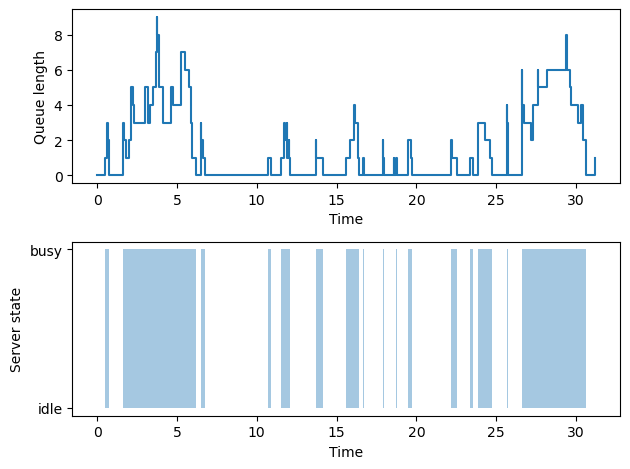

In [12]:
if LOGGED and PLOTTED:
    import matplotlib.pyplot as plt
    if RENEGED:
        log = np.loadtxt('mm1SD-l%d-m%d-w%d.csv' %(LAMBDA, MU, MAXWAITTIME), delimiter = '\t')
    else:
        log = np.loadtxt('mm1-l%d-m%d.csv' %(LAMBDA, MU), delimiter = '\t')
    plt.subplot(2, 1, 1)
    plt.xlabel('Time')
    plt.ylabel('Queue length')
    plt.step(log[:200,0], log[:200,2], where='post')
    plt.subplot(2, 1, 2)
    plt.xlabel('Time' )
    plt.ylabel('Server state' )
    plt.yticks([0, 1], ['idle', 'busy'])
    #plt.step( log[:200,0], log[:200,1], where='post' )
    plt.fill_between(log[:200,0], 0, log[:200,1], step="post", alpha=.4)
    plt.tight_layout()
    plt.show()